In [34]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import torch
import torch.nn as nn
from sklearn.model_selection import train_test_split
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
from torch.utils.tensorboard import SummaryWriter
#from torchviz import make_dot
import torch.onnx
import glob
from PIL import Image
import time
from torchview import draw_graph 
from torchinfo import summary
import torch.nn.functional as F
import os
import onnx
import seaborn as sns
import matplotlib
import random
import gc
import torch.optim as optim
from tqdm import tqdm

def set_seed(seed):
    # Set the seed for Python's built-in random module
    random.seed(seed)
    
    # Set the seed for NumPy
    np.random.seed(seed)
    
    # Set the seed for PyTorch
    torch.manual_seed(seed)
    
    # If you are using CUDA, also set the seed for the GPU
    if torch.cuda.is_available():
        torch.cuda.manual_seed(seed)

    # Ensure deterministic behavior in PyTorch
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

# Example usage
set_seed(42)


print(os.getcwd())
os.chdir('/home/cualum/Documents/UT_Austin_MSAIO/Case studies machine learning/celectial object classification')

/home/cualum/Documents/UT_Austin_MSAIO/Case studies machine learning/celectial object classification


In [35]:
file_list = glob.glob('images_training_rev1/*.jpg')


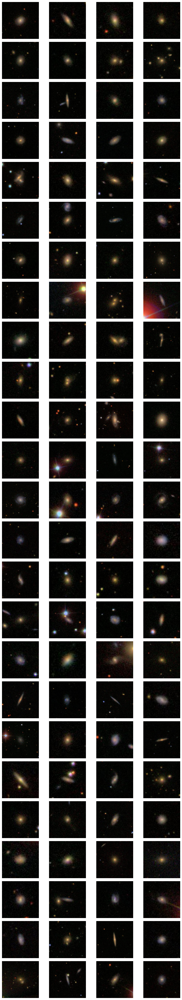

(424, 424)


In [36]:
images = []
sizes = []
channels = []
cropped_images = []
cropped_sizes = []  # To store the sizes of cropped images
crop_percent = 0.4  # Crop to 40% of the original size

for file_path in file_list[:100]:  # Get only the first 20 files
    img = Image.open(file_path)
    images.append(img)
    sizes.append(img.size)
    channels.append(img.mode)

# Display the cropped images
plt.figure(figsize=(10, 50))
for i, img in enumerate(images):
    plt.subplot(25, 4, i + 1)  # Create a grid for display
    plt.imshow(img)
    plt.axis('off')  # Hide axes
plt.tight_layout()
plt.show()
print(img.size)

Cropped Image 1: size = (169, 169)
Cropped Image 2: size = (169, 169)
Cropped Image 3: size = (169, 169)
Cropped Image 4: size = (169, 169)
Cropped Image 5: size = (169, 169)
Cropped Image 6: size = (169, 169)
Cropped Image 7: size = (169, 169)
Cropped Image 8: size = (169, 169)
Cropped Image 9: size = (169, 169)
Cropped Image 10: size = (169, 169)
Cropped Image 11: size = (169, 169)
Cropped Image 12: size = (169, 169)
Cropped Image 13: size = (169, 169)
Cropped Image 14: size = (169, 169)
Cropped Image 15: size = (169, 169)
Cropped Image 16: size = (169, 169)
Cropped Image 17: size = (169, 169)
Cropped Image 18: size = (169, 169)
Cropped Image 19: size = (169, 169)
Cropped Image 20: size = (169, 169)


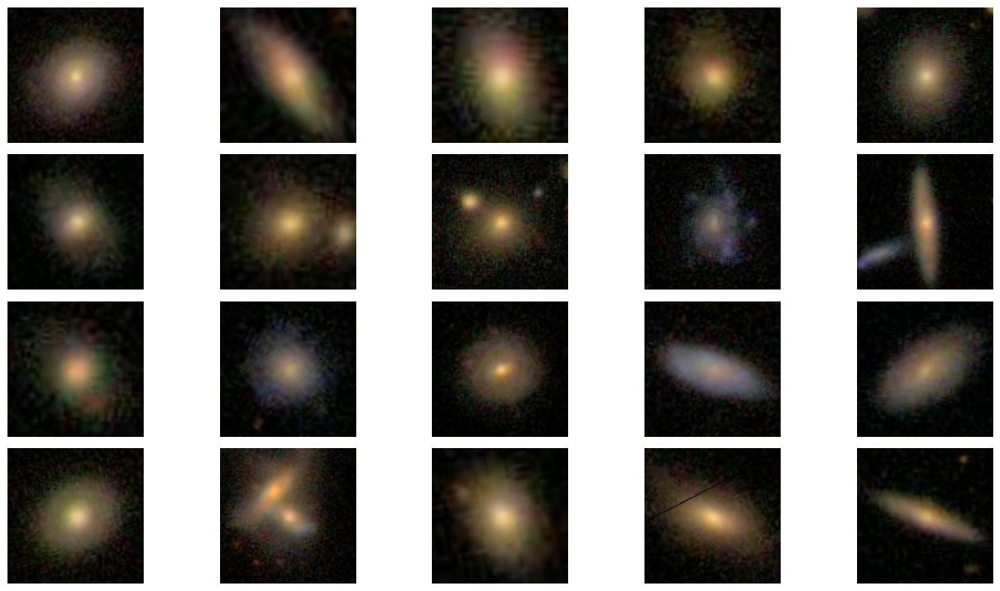

In [37]:
images = []
sizes = []
channels = []
cropped_images = []
cropped_sizes = []  # To store the sizes of cropped images
crop_percent = 0.4  # Crop to 50% of the original size

for file_path in file_list[:20]:  # Get only the first 20 files
    img = Image.open(file_path)
    images.append(img)
    sizes.append(img.size)
    channels.append(img.mode)

    # Calculate center cropping based on percentage
    width, height = img.size
    new_width = int(width * crop_percent)
    new_height = int(height * crop_percent)

    # Calculate cropping box coordinates
    left = (width - new_width) // 2
    upper = (height - new_height) // 2
    right = (width + new_width) // 2
    lower = (height + new_height) // 2

    img_cropped = img.crop((left, upper, right, lower))  # Crop based on calculated box
    cropped_images.append(img_cropped)
    cropped_sizes.append(img_cropped.size)  # Store the size of the cropped image

# Print sizes of the cropped images
for i, cropped_size in enumerate(cropped_sizes):
    print(f"Cropped Image {i + 1}: size = {cropped_size}")

# Display the cropped images
plt.figure(figsize=(15, 8))
for i, img in enumerate(cropped_images):
    plt.subplot(4, 5, i + 1)  # Create a grid for display
    plt.imshow(img)
    plt.axis('off')  # Hide axes
plt.tight_layout()
plt.show()


In [38]:
# Define a custom dataset class
class ImageDataset(Dataset):
    def __init__(self, data_frame, image_folder, transform=None):
        self.data_frame = data_frame
        self.image_folder = image_folder  # Folder containing images
        self.transform = transform

    def __len__(self):
        return len(self.data_frame)

    def __getitem__(self, idx):
        img_name = str(self.data_frame.iloc[idx, 0]) + '.jpg'  # Assuming the first column is the image name
        label = self.data_frame.iloc[idx, 1:38].values  # Assuming labels are in columns 1 to 37

        img_path = os.path.join(self.image_folder, img_name)  # Construct full path
        img = Image.open(img_path)

        if self.transform:
            img = self.transform(img)

        label = torch.tensor(label, dtype=torch.float)  # Convert to tensor
        return img, label

In [39]:
def calculate_metrics(outputs, labels):
    mse = torch.mean((outputs - labels) ** 2)
    rmse = torch.sqrt(mse)
    mae = torch.mean(torch.abs(outputs - labels))
    return mae.item(), mse.item(), rmse.item()

In [40]:
def train(batch_size, classifier, num_epochs):

    data = pd.DataFrame(columns = ['batch size', 'epoch', 'time','train loss', 'train RMSE', 'test loss', 'test RMSE'])
    start_time = time.time()

    csv_file = 'training_solutions_rev1.csv'
    image_folder = 'images_training_rev1'
    data_frame = pd.read_csv(csv_file)
    
    # Split the data into training and testing sets
    train_df, test_df = train_test_split(data_frame, test_size=0.2, random_state=42)
    
    # Define the transformations
    transform_train = transforms.Compose([
        transforms.RandomRotation(degrees=90),          # Random rotation between -30 and 30 degrees
        transforms.CenterCrop(size=(180, 180)),        # Center crop to 224x224
        transforms.RandomHorizontalFlip(),
        transforms.RandomVerticalFlip(),
        transforms.ColorJitter(                          # Adjust brightness, contrast, saturation, and hue
            brightness=0.1,  # Change brightness by ±20%
            contrast=0.1,    # Change contrast by ±20%
            #saturation=0.1,  # Change saturation by ±20%
            #hue=0.1          # Change hue by ±0.1
        ),
        transforms.ToTensor(),                           # Convert the image to a tensor
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Normalize
    ])
    
    transform_valid = transforms.Compose([        # Random rotation between -30 and 30 degrees
        transforms.CenterCrop(size=(180, 180)),        # Center crop to 224x224
        transforms.ToTensor(),                           # Convert the image to a tensor
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Normalize
    ])
    
    # Create the datasets
    train_dataset = ImageDataset(data_frame=train_df, image_folder=image_folder, transform=transform_train)
    test_dataset = ImageDataset(data_frame=test_df, image_folder=image_folder, transform=transform_valid)
    
    # Create the DataLoaders
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers = 24)
    test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers = 24)


    if classifier == 'RES3':
        model = ResNet3()
    if classifier == 'RES2':
        model = ResNet2()
    if classifier == 'RES1':
        model = ResNet1()
    if classifier == 'BASICNEW2':
        model = BasicNetwork_new2()
    if classifier == 'BASICNEW1':
        model = BasicNetwork_new1()
    if classifier == 'BASICNEW3':
        model = BasicNetwork_new3()
    if classifier == 'RES2test':
        model = ResNet2_test()


    
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu") 
    print(device)



    model.to(device)
    dummy_input = torch.randn(1, 3, 180, 180).to('cpu').to(device)
    net_graph = draw_graph(model, input_data=dummy_input)
    filename = net_graph.visual_graph.render(filename= classifier, format='pdf', cleanup=True)
    print("Graph saved to:", filename)
    model.to(device)

    
    optimizer = torch.optim.Adam(model.parameters(), lr = .0001)
    scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=20, gamma=0.66)
    #scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.8)
    criterion = torch.nn.MSELoss()  # For regression

    # Initialize TensorBoard SummaryWriter
    #writer = SummaryWriter()

    # Training loop
    for epoch in range(num_epochs):
        
        print('epoch:', epoch+1)
        model.train()
        total_loss = 0
        total_mae = 0
        total_mse = 0
        total_rmse = 0
        progress_bar = tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs}", unit="batch")
        for batch, (images, labels) in enumerate(progress_bar):
            images = images.to(device)
            labels = labels.to(device).float()  # Ensure labels are float for MSE
            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, labels)

            progress_bar.set_postfix(loss=f"{loss.item():.4f}")

            # Calculate metrics
            train_mae, train_mse, train_rmse = calculate_metrics(outputs, labels)
            loss.backward()
            optimizer.step()

            total_loss += loss.item()
            total_mae += train_mae
            total_mse += train_mse
            total_rmse += train_rmse
            '''
            if batch % 10 == 0:
                print(f'Batch {batch}, Loss: {loss.item()}, Train RMSE: {train_rmse}')'''
        scheduler.step()
        # Average metrics for the epoch
        avg_loss = total_loss / (batch+1)
        avg_mae = total_mae / (batch+1)
        avg_mse = total_mse / (batch+1)
        avg_rmse = total_rmse / (batch+1)

        # Log metrics to TensorBoard
        #writer.add_scalar('Loss/train', avg_loss, epoch)
        #writer.add_scalar('MAE/train', avg_mae, epoch)
        #writer.add_scalar('MSE/train', avg_mse, epoch)
        #writer.add_scalar('RMSE/train', avg_rmse, epoch)

        # Testing loop
        model.eval()
        total_test_loss = 0
        total_test_mae = 0
        total_test_mse = 0
        total_test_rmse = 0

        with torch.no_grad():
            for batch, (images, labels) in enumerate(test_loader):
                images = images.to(device)
                labels = labels.to(device).float()  # Ensure labels are float for MSE
                outputs = model(images)
                test_loss = criterion(outputs, labels).item()


                # Calculate test metrics
                test_mae, test_mse, test_rmse = calculate_metrics(outputs, labels)
                total_test_mae += test_mae
                total_test_mse += test_mse
                total_test_rmse += test_rmse
                total_test_loss += test_loss
                '''
                if batch % 10 == 0:
                    print(f'Batch {batch}, Loss: {test_loss}, Test RMSE: {test_rmse}')'''

        avg_test_loss = total_test_loss / (batch+1)
        avg_test_mae = total_test_mae / (batch+1)
        avg_test_mse = total_test_mse / (batch+1)
        avg_test_rmse = total_test_rmse / (batch+1)
        '''
        print(f'Epoch [{epoch+1}/{num_epochs}], '
              f'Train Loss: {avg_loss:.4f}, '
              f'Test Loss: {avg_test_loss:.4f}')'''
        print(f'Epoch [{epoch+1}/{num_epochs}], '
              f'Train RMSE: {avg_rmse:.4f}, '
              f'Test RMSE: {avg_test_rmse:.4f}')
        elapsed_time = time.time() - start_time

        
        data.loc[len(data)] = [batch_size, epoch+1, elapsed_time, avg_loss, avg_rmse, avg_test_loss, avg_test_rmse]
        '''display(data)'''

        filename = classifier + '.csv'
        data.to_csv(filename)
    
        if elapsed_time >10000:
            break


    # Close the writer 
    #writer.close()
    model_file_name = classifier + '.pth'
    torch.save(model, model_file_name)

    

In [9]:
torch.cuda.empty_cache()
gc.collect()

0

In [21]:
train(batch_size = 1000, classifier = 'RES2test', num_epochs = 100)

cuda
Graph saved to: RES2test.pdf
epoch: 1


Epoch 1/100: 100%|██████████| 50/50 [00:36<00:00,  1.39batch/s, loss=0.0145]


Epoch [1/100], Train RMSE: 0.1403, Test RMSE: 0.1335
epoch: 2


Epoch 2/100: 100%|██████████| 50/50 [00:35<00:00,  1.41batch/s, loss=0.0142]


Epoch [2/100], Train RMSE: 0.1177, Test RMSE: 0.1185
epoch: 3


Epoch 3/100: 100%|██████████| 50/50 [00:35<00:00,  1.40batch/s, loss=0.0118]


Epoch [3/100], Train RMSE: 0.1090, Test RMSE: 0.1195
epoch: 4


Epoch 4/100: 100%|██████████| 50/50 [00:36<00:00,  1.39batch/s, loss=0.0105]


Epoch [4/100], Train RMSE: 0.1044, Test RMSE: 0.1072
epoch: 5


Epoch 5/100: 100%|██████████| 50/50 [00:35<00:00,  1.40batch/s, loss=0.0095]


Epoch [5/100], Train RMSE: 0.1017, Test RMSE: 0.1037
epoch: 6


Epoch 6/100: 100%|██████████| 50/50 [00:36<00:00,  1.39batch/s, loss=0.0100]


Epoch [6/100], Train RMSE: 0.0996, Test RMSE: 0.1015
epoch: 7


Epoch 7/100: 100%|██████████| 50/50 [00:35<00:00,  1.41batch/s, loss=0.0101]


Epoch [7/100], Train RMSE: 0.0985, Test RMSE: 0.1034
epoch: 8


Epoch 8/100: 100%|██████████| 50/50 [00:36<00:00,  1.39batch/s, loss=0.0093]


Epoch [8/100], Train RMSE: 0.0973, Test RMSE: 0.1000
epoch: 9


Epoch 9/100: 100%|██████████| 50/50 [00:35<00:00,  1.40batch/s, loss=0.0089]


Epoch [9/100], Train RMSE: 0.0960, Test RMSE: 0.0968
epoch: 10


Epoch 10/100: 100%|██████████| 50/50 [00:35<00:00,  1.39batch/s, loss=0.0082]


Epoch [10/100], Train RMSE: 0.0949, Test RMSE: 0.0980
epoch: 11


Epoch 11/100: 100%|██████████| 50/50 [00:35<00:00,  1.39batch/s, loss=0.0084]


Epoch [11/100], Train RMSE: 0.0941, Test RMSE: 0.0946
epoch: 12


Epoch 12/100: 100%|██████████| 50/50 [00:35<00:00,  1.39batch/s, loss=0.0081]


Epoch [12/100], Train RMSE: 0.0932, Test RMSE: 0.0964
epoch: 13


Epoch 13/100: 100%|██████████| 50/50 [00:34<00:00,  1.43batch/s, loss=0.0088]


Epoch [13/100], Train RMSE: 0.0928, Test RMSE: 0.0931
epoch: 14


Epoch 14/100: 100%|██████████| 50/50 [00:35<00:00,  1.40batch/s, loss=0.0085]


Epoch [14/100], Train RMSE: 0.0918, Test RMSE: 0.0927
epoch: 15


Epoch 15/100: 100%|██████████| 50/50 [00:35<00:00,  1.43batch/s, loss=0.0084]


Epoch [15/100], Train RMSE: 0.0917, Test RMSE: 0.0937
epoch: 16


Epoch 16/100: 100%|██████████| 50/50 [00:35<00:00,  1.41batch/s, loss=0.0088]


Epoch [16/100], Train RMSE: 0.0911, Test RMSE: 0.0920
epoch: 17


Epoch 17/100: 100%|██████████| 50/50 [00:34<00:00,  1.44batch/s, loss=0.0088]


Epoch [17/100], Train RMSE: 0.0905, Test RMSE: 0.0935
epoch: 18


Epoch 18/100: 100%|██████████| 50/50 [00:34<00:00,  1.43batch/s, loss=0.0080]


Epoch [18/100], Train RMSE: 0.0902, Test RMSE: 0.0924
epoch: 19


Epoch 19/100: 100%|██████████| 50/50 [00:34<00:00,  1.43batch/s, loss=0.0083]


Epoch [19/100], Train RMSE: 0.0897, Test RMSE: 0.0916
epoch: 20


Epoch 20/100: 100%|██████████| 50/50 [00:35<00:00,  1.42batch/s, loss=0.0083]


Epoch [20/100], Train RMSE: 0.0892, Test RMSE: 0.0904
epoch: 21


Epoch 21/100: 100%|██████████| 50/50 [00:35<00:00,  1.42batch/s, loss=0.0077]


Epoch [21/100], Train RMSE: 0.0878, Test RMSE: 0.0889
epoch: 22


Epoch 22/100: 100%|██████████| 50/50 [00:35<00:00,  1.42batch/s, loss=0.0074]


Epoch [22/100], Train RMSE: 0.0872, Test RMSE: 0.0889
epoch: 23


Epoch 23/100: 100%|██████████| 50/50 [00:34<00:00,  1.44batch/s, loss=0.0080]


Epoch [23/100], Train RMSE: 0.0872, Test RMSE: 0.0900
epoch: 24


Epoch 24/100: 100%|██████████| 50/50 [00:35<00:00,  1.42batch/s, loss=0.0071]


Epoch [24/100], Train RMSE: 0.0869, Test RMSE: 0.0884
epoch: 25


Epoch 25/100: 100%|██████████| 50/50 [00:35<00:00,  1.40batch/s, loss=0.0074]


Epoch [25/100], Train RMSE: 0.0865, Test RMSE: 0.0883
epoch: 26


Epoch 26/100: 100%|██████████| 50/50 [00:36<00:00,  1.38batch/s, loss=0.0073]


Epoch [26/100], Train RMSE: 0.0862, Test RMSE: 0.0893
epoch: 27


Epoch 27/100: 100%|██████████| 50/50 [00:38<00:00,  1.31batch/s, loss=0.0071]


Epoch [27/100], Train RMSE: 0.0861, Test RMSE: 0.0892
epoch: 28


Epoch 28/100: 100%|██████████| 50/50 [00:36<00:00,  1.37batch/s, loss=0.0074]


Epoch [28/100], Train RMSE: 0.0859, Test RMSE: 0.0892
epoch: 29


Epoch 29/100: 100%|██████████| 50/50 [00:36<00:00,  1.38batch/s, loss=0.0066]


Epoch [29/100], Train RMSE: 0.0857, Test RMSE: 0.0888
epoch: 30


Epoch 30/100: 100%|██████████| 50/50 [00:36<00:00,  1.38batch/s, loss=0.0072]


Epoch [30/100], Train RMSE: 0.0857, Test RMSE: 0.0878
epoch: 31


Epoch 31/100: 100%|██████████| 50/50 [00:36<00:00,  1.36batch/s, loss=0.0075]


Epoch [31/100], Train RMSE: 0.0854, Test RMSE: 0.0873
epoch: 32


Epoch 32/100: 100%|██████████| 50/50 [00:36<00:00,  1.37batch/s, loss=0.0072]


Epoch [32/100], Train RMSE: 0.0850, Test RMSE: 0.0873
epoch: 33


Epoch 33/100: 100%|██████████| 50/50 [00:35<00:00,  1.40batch/s, loss=0.0071]


Epoch [33/100], Train RMSE: 0.0848, Test RMSE: 0.0879
epoch: 34


Epoch 34/100: 100%|██████████| 50/50 [00:36<00:00,  1.39batch/s, loss=0.0075]


Epoch [34/100], Train RMSE: 0.0846, Test RMSE: 0.0880
epoch: 35


Epoch 35/100: 100%|██████████| 50/50 [00:35<00:00,  1.40batch/s, loss=0.0069]


Epoch [35/100], Train RMSE: 0.0843, Test RMSE: 0.0883
epoch: 36


Epoch 36/100: 100%|██████████| 50/50 [00:36<00:00,  1.39batch/s, loss=0.0064]


Epoch [36/100], Train RMSE: 0.0842, Test RMSE: 0.0873
epoch: 37


Epoch 37/100: 100%|██████████| 50/50 [00:37<00:00,  1.34batch/s, loss=0.0074]


Epoch [37/100], Train RMSE: 0.0838, Test RMSE: 0.0875
epoch: 38


Epoch 38/100: 100%|██████████| 50/50 [00:35<00:00,  1.40batch/s, loss=0.0068]


Epoch [38/100], Train RMSE: 0.0840, Test RMSE: 0.0880
epoch: 39


Epoch 39/100: 100%|██████████| 50/50 [00:36<00:00,  1.38batch/s, loss=0.0079]


Epoch [39/100], Train RMSE: 0.0837, Test RMSE: 0.0865
epoch: 40


Epoch 40/100: 100%|██████████| 50/50 [00:36<00:00,  1.36batch/s, loss=0.0070]


Epoch [40/100], Train RMSE: 0.0831, Test RMSE: 0.0876
epoch: 41


Epoch 41/100: 100%|██████████| 50/50 [00:35<00:00,  1.40batch/s, loss=0.0065]


Epoch [41/100], Train RMSE: 0.0822, Test RMSE: 0.0851
epoch: 42


Epoch 42/100: 100%|██████████| 50/50 [00:36<00:00,  1.36batch/s, loss=0.0065]


Epoch [42/100], Train RMSE: 0.0820, Test RMSE: 0.0859
epoch: 43


Epoch 43/100: 100%|██████████| 50/50 [00:37<00:00,  1.34batch/s, loss=0.0070]


Epoch [43/100], Train RMSE: 0.0817, Test RMSE: 0.0847
epoch: 44


Epoch 44/100: 100%|██████████| 50/50 [00:36<00:00,  1.37batch/s, loss=0.0074]


Epoch [44/100], Train RMSE: 0.0816, Test RMSE: 0.0855
epoch: 45


Epoch 45/100: 100%|██████████| 50/50 [00:35<00:00,  1.41batch/s, loss=0.0061]


Epoch [45/100], Train RMSE: 0.0815, Test RMSE: 0.0857
epoch: 46


Epoch 46/100: 100%|██████████| 50/50 [00:35<00:00,  1.42batch/s, loss=0.0066]


Epoch [46/100], Train RMSE: 0.0811, Test RMSE: 0.0851
epoch: 47


Epoch 47/100: 100%|██████████| 50/50 [00:35<00:00,  1.40batch/s, loss=0.0058]


Epoch [47/100], Train RMSE: 0.0809, Test RMSE: 0.0851
epoch: 48


Epoch 48/100: 100%|██████████| 50/50 [00:35<00:00,  1.40batch/s, loss=0.0062]


Epoch [48/100], Train RMSE: 0.0809, Test RMSE: 0.0844
epoch: 49


Epoch 49/100: 100%|██████████| 50/50 [00:35<00:00,  1.42batch/s, loss=0.0066]


Epoch [49/100], Train RMSE: 0.0806, Test RMSE: 0.0857
epoch: 50


Epoch 50/100: 100%|██████████| 50/50 [00:35<00:00,  1.40batch/s, loss=0.0061]


Epoch [50/100], Train RMSE: 0.0806, Test RMSE: 0.0843
epoch: 51


Epoch 51/100: 100%|██████████| 50/50 [00:35<00:00,  1.40batch/s, loss=0.0066]


Epoch [51/100], Train RMSE: 0.0804, Test RMSE: 0.0852
epoch: 52


Epoch 52/100: 100%|██████████| 50/50 [00:35<00:00,  1.40batch/s, loss=0.0063]


Epoch [52/100], Train RMSE: 0.0805, Test RMSE: 0.0839
epoch: 53


Epoch 53/100: 100%|██████████| 50/50 [00:35<00:00,  1.42batch/s, loss=0.0063]


Epoch [53/100], Train RMSE: 0.0802, Test RMSE: 0.0861
epoch: 54


Epoch 54/100: 100%|██████████| 50/50 [00:35<00:00,  1.39batch/s, loss=0.0058]


Epoch [54/100], Train RMSE: 0.0800, Test RMSE: 0.0842
epoch: 55


Epoch 55/100: 100%|██████████| 50/50 [00:35<00:00,  1.41batch/s, loss=0.0063]


Epoch [55/100], Train RMSE: 0.0800, Test RMSE: 0.0852
epoch: 56


Epoch 56/100: 100%|██████████| 50/50 [00:35<00:00,  1.41batch/s, loss=0.0059]


Epoch [56/100], Train RMSE: 0.0797, Test RMSE: 0.0842
epoch: 57


Epoch 57/100: 100%|██████████| 50/50 [00:36<00:00,  1.37batch/s, loss=0.0068]


Epoch [57/100], Train RMSE: 0.0796, Test RMSE: 0.0837
epoch: 58


Epoch 58/100: 100%|██████████| 50/50 [00:35<00:00,  1.41batch/s, loss=0.0057]


Epoch [58/100], Train RMSE: 0.0793, Test RMSE: 0.0843
epoch: 59


Epoch 59/100: 100%|██████████| 50/50 [00:36<00:00,  1.38batch/s, loss=0.0065]


Epoch [59/100], Train RMSE: 0.0794, Test RMSE: 0.0837
epoch: 60


Epoch 60/100: 100%|██████████| 50/50 [00:35<00:00,  1.39batch/s, loss=0.0066]


Epoch [60/100], Train RMSE: 0.0795, Test RMSE: 0.0854
epoch: 61


Epoch 61/100: 100%|██████████| 50/50 [00:36<00:00,  1.38batch/s, loss=0.0065]


Epoch [61/100], Train RMSE: 0.0789, Test RMSE: 0.0836
epoch: 62


Epoch 62/100: 100%|██████████| 50/50 [00:36<00:00,  1.35batch/s, loss=0.0064]


Epoch [62/100], Train RMSE: 0.0786, Test RMSE: 0.0832
epoch: 63


Epoch 63/100: 100%|██████████| 50/50 [00:37<00:00,  1.34batch/s, loss=0.0063]


Epoch [63/100], Train RMSE: 0.0783, Test RMSE: 0.0833
epoch: 64


Epoch 64/100: 100%|██████████| 50/50 [00:35<00:00,  1.40batch/s, loss=0.0062]


Epoch [64/100], Train RMSE: 0.0781, Test RMSE: 0.0837
epoch: 65


Epoch 65/100: 100%|██████████| 50/50 [00:36<00:00,  1.36batch/s, loss=0.0057]


Epoch [65/100], Train RMSE: 0.0780, Test RMSE: 0.0833
epoch: 66


Epoch 66/100: 100%|██████████| 50/50 [00:37<00:00,  1.32batch/s, loss=0.0056]


Epoch [66/100], Train RMSE: 0.0780, Test RMSE: 0.0839
epoch: 67


Epoch 67/100: 100%|██████████| 50/50 [00:37<00:00,  1.32batch/s, loss=0.0059]


Epoch [67/100], Train RMSE: 0.0778, Test RMSE: 0.0834
epoch: 68


Epoch 68/100: 100%|██████████| 50/50 [00:36<00:00,  1.37batch/s, loss=0.0063]


Epoch [68/100], Train RMSE: 0.0778, Test RMSE: 0.0835
epoch: 69


Epoch 69/100: 100%|██████████| 50/50 [00:35<00:00,  1.40batch/s, loss=0.0065]


Epoch [69/100], Train RMSE: 0.0777, Test RMSE: 0.0830
epoch: 70


Epoch 70/100: 100%|██████████| 50/50 [00:36<00:00,  1.35batch/s, loss=0.0059]


Epoch [70/100], Train RMSE: 0.0776, Test RMSE: 0.0835
epoch: 71


Epoch 71/100: 100%|██████████| 50/50 [00:36<00:00,  1.36batch/s, loss=0.0065]


Epoch [71/100], Train RMSE: 0.0776, Test RMSE: 0.0834
epoch: 72


Epoch 72/100: 100%|██████████| 50/50 [00:36<00:00,  1.37batch/s, loss=0.0062]


Epoch [72/100], Train RMSE: 0.0775, Test RMSE: 0.0834
epoch: 73


Epoch 73/100: 100%|██████████| 50/50 [00:36<00:00,  1.39batch/s, loss=0.0066]


Epoch [73/100], Train RMSE: 0.0774, Test RMSE: 0.0832
epoch: 74


Epoch 74/100: 100%|██████████| 50/50 [00:35<00:00,  1.43batch/s, loss=0.0063]


Epoch [74/100], Train RMSE: 0.0773, Test RMSE: 0.0834
epoch: 75


Epoch 75/100: 100%|██████████| 50/50 [00:35<00:00,  1.43batch/s, loss=0.0063]


Epoch [75/100], Train RMSE: 0.0771, Test RMSE: 0.0831
epoch: 76


Epoch 76/100: 100%|██████████| 50/50 [00:36<00:00,  1.38batch/s, loss=0.0061]


Epoch [76/100], Train RMSE: 0.0772, Test RMSE: 0.0840
epoch: 77


Epoch 77/100: 100%|██████████| 50/50 [00:36<00:00,  1.38batch/s, loss=0.0063]


Epoch [77/100], Train RMSE: 0.0770, Test RMSE: 0.0852
epoch: 78


Epoch 78/100: 100%|██████████| 50/50 [00:36<00:00,  1.38batch/s, loss=0.0059]


Epoch [78/100], Train RMSE: 0.0771, Test RMSE: 0.0837
epoch: 79


Epoch 79/100: 100%|██████████| 50/50 [00:35<00:00,  1.42batch/s, loss=0.0064]


Epoch [79/100], Train RMSE: 0.0770, Test RMSE: 0.0836
epoch: 80


Epoch 80/100: 100%|██████████| 50/50 [00:36<00:00,  1.39batch/s, loss=0.0057]


Epoch [80/100], Train RMSE: 0.0766, Test RMSE: 0.0838
epoch: 81


Epoch 81/100: 100%|██████████| 50/50 [00:35<00:00,  1.41batch/s, loss=0.0065]


Epoch [81/100], Train RMSE: 0.0763, Test RMSE: 0.0827
epoch: 82


Epoch 82/100: 100%|██████████| 50/50 [00:36<00:00,  1.38batch/s, loss=0.0062]


Epoch [82/100], Train RMSE: 0.0761, Test RMSE: 0.0830
epoch: 83


Epoch 83/100: 100%|██████████| 50/50 [00:35<00:00,  1.40batch/s, loss=0.0060]


Epoch [83/100], Train RMSE: 0.0760, Test RMSE: 0.0830
epoch: 84


Epoch 84/100: 100%|██████████| 50/50 [00:36<00:00,  1.36batch/s, loss=0.0066]


Epoch [84/100], Train RMSE: 0.0760, Test RMSE: 0.0830
epoch: 85


Epoch 85/100: 100%|██████████| 50/50 [00:36<00:00,  1.38batch/s, loss=0.0057]


Epoch [85/100], Train RMSE: 0.0759, Test RMSE: 0.0830
epoch: 86


Epoch 86/100: 100%|██████████| 50/50 [00:35<00:00,  1.41batch/s, loss=0.0061]


Epoch [86/100], Train RMSE: 0.0758, Test RMSE: 0.0827
epoch: 87


Epoch 87/100: 100%|██████████| 50/50 [00:35<00:00,  1.41batch/s, loss=0.0056]


Epoch [87/100], Train RMSE: 0.0757, Test RMSE: 0.0831
epoch: 88


Epoch 88/100: 100%|██████████| 50/50 [00:35<00:00,  1.42batch/s, loss=0.0058]


Epoch [88/100], Train RMSE: 0.0755, Test RMSE: 0.0831
epoch: 89


Epoch 89/100: 100%|██████████| 50/50 [00:35<00:00,  1.40batch/s, loss=0.0052]


Epoch [89/100], Train RMSE: 0.0754, Test RMSE: 0.0829
epoch: 90


Epoch 90/100: 100%|██████████| 50/50 [00:35<00:00,  1.40batch/s, loss=0.0059]


Epoch [90/100], Train RMSE: 0.0755, Test RMSE: 0.0832
epoch: 91


Epoch 91/100: 100%|██████████| 50/50 [00:35<00:00,  1.40batch/s, loss=0.0058]


Epoch [91/100], Train RMSE: 0.0754, Test RMSE: 0.0836
epoch: 92


Epoch 92/100: 100%|██████████| 50/50 [00:35<00:00,  1.42batch/s, loss=0.0066]


Epoch [92/100], Train RMSE: 0.0753, Test RMSE: 0.0828
epoch: 93


Epoch 93/100: 100%|██████████| 50/50 [00:35<00:00,  1.42batch/s, loss=0.0058]


Epoch [93/100], Train RMSE: 0.0753, Test RMSE: 0.0829
epoch: 94


Epoch 94/100: 100%|██████████| 50/50 [00:35<00:00,  1.40batch/s, loss=0.0061]


Epoch [94/100], Train RMSE: 0.0753, Test RMSE: 0.0828
epoch: 95


Epoch 95/100: 100%|██████████| 50/50 [00:36<00:00,  1.38batch/s, loss=0.0056]


Epoch [95/100], Train RMSE: 0.0751, Test RMSE: 0.0833
epoch: 96


Epoch 96/100: 100%|██████████| 50/50 [00:35<00:00,  1.40batch/s, loss=0.0057]


Epoch [96/100], Train RMSE: 0.0750, Test RMSE: 0.0829
epoch: 97


Epoch 97/100: 100%|██████████| 50/50 [00:36<00:00,  1.39batch/s, loss=0.0057]


Epoch [97/100], Train RMSE: 0.0751, Test RMSE: 0.0833
epoch: 98


Epoch 98/100: 100%|██████████| 50/50 [00:36<00:00,  1.38batch/s, loss=0.0055]


Epoch [98/100], Train RMSE: 0.0748, Test RMSE: 0.0828
epoch: 99


Epoch 99/100: 100%|██████████| 50/50 [00:35<00:00,  1.40batch/s, loss=0.0058]


Epoch [99/100], Train RMSE: 0.0748, Test RMSE: 0.0828
epoch: 100


Epoch 100/100: 100%|██████████| 50/50 [00:35<00:00,  1.40batch/s, loss=0.0057]


Epoch [100/100], Train RMSE: 0.0747, Test RMSE: 0.0836


In [42]:
train(batch_size = 1000, classifier = 'BASICNEW2', num_epochs = 100)

cuda
Graph saved to: BASICNEW2.pdf
epoch: 1


Epoch 1/100: 100%|██████████| 50/50 [00:26<00:00,  1.89batch/s, loss=0.0154]


Epoch [1/100], Train RMSE: 0.1405, Test RMSE: 0.1280
epoch: 2


Epoch 2/100: 100%|██████████| 50/50 [00:26<00:00,  1.89batch/s, loss=0.0139]


Epoch [2/100], Train RMSE: 0.1159, Test RMSE: 0.1147
epoch: 3


Epoch 3/100: 100%|██████████| 50/50 [00:27<00:00,  1.84batch/s, loss=0.0108]


Epoch [3/100], Train RMSE: 0.1081, Test RMSE: 0.1108
epoch: 4


Epoch 4/100: 100%|██████████| 50/50 [00:28<00:00,  1.76batch/s, loss=0.0111]


Epoch [4/100], Train RMSE: 0.1037, Test RMSE: 0.1043
epoch: 5


Epoch 5/100: 100%|██████████| 50/50 [00:27<00:00,  1.84batch/s, loss=0.0112]


Epoch [5/100], Train RMSE: 0.1010, Test RMSE: 0.1015
epoch: 6


Epoch 6/100: 100%|██████████| 50/50 [00:27<00:00,  1.80batch/s, loss=0.0091]


Epoch [6/100], Train RMSE: 0.0990, Test RMSE: 0.0998
epoch: 7


Epoch 7/100: 100%|██████████| 50/50 [00:27<00:00,  1.81batch/s, loss=0.0088]


Epoch [7/100], Train RMSE: 0.0972, Test RMSE: 0.0987
epoch: 8


Epoch 8/100: 100%|██████████| 50/50 [00:27<00:00,  1.81batch/s, loss=0.0092]


Epoch [8/100], Train RMSE: 0.0965, Test RMSE: 0.1020
epoch: 9


Epoch 9/100: 100%|██████████| 50/50 [00:27<00:00,  1.81batch/s, loss=0.0095]


Epoch [9/100], Train RMSE: 0.0950, Test RMSE: 0.0956
epoch: 10


Epoch 10/100: 100%|██████████| 50/50 [00:27<00:00,  1.84batch/s, loss=0.0095]


Epoch [10/100], Train RMSE: 0.0943, Test RMSE: 0.0957
epoch: 11


Epoch 11/100: 100%|██████████| 50/50 [00:26<00:00,  1.88batch/s, loss=0.0093]


Epoch [11/100], Train RMSE: 0.0933, Test RMSE: 0.0963
epoch: 12


Epoch 12/100: 100%|██████████| 50/50 [00:26<00:00,  1.91batch/s, loss=0.0085]


Epoch [12/100], Train RMSE: 0.0929, Test RMSE: 0.0946
epoch: 13


Epoch 13/100: 100%|██████████| 50/50 [00:26<00:00,  1.90batch/s, loss=0.0090]


Epoch [13/100], Train RMSE: 0.0920, Test RMSE: 0.0935
epoch: 14


Epoch 14/100: 100%|██████████| 50/50 [00:26<00:00,  1.86batch/s, loss=0.0078]


Epoch [14/100], Train RMSE: 0.0914, Test RMSE: 0.0941
epoch: 15


Epoch 15/100: 100%|██████████| 50/50 [00:26<00:00,  1.89batch/s, loss=0.0088]


Epoch [15/100], Train RMSE: 0.0910, Test RMSE: 0.0919
epoch: 16


Epoch 16/100: 100%|██████████| 50/50 [00:26<00:00,  1.86batch/s, loss=0.0076]


Epoch [16/100], Train RMSE: 0.0902, Test RMSE: 0.0922
epoch: 17


Epoch 17/100: 100%|██████████| 50/50 [00:26<00:00,  1.89batch/s, loss=0.0084]


Epoch [17/100], Train RMSE: 0.0895, Test RMSE: 0.0928
epoch: 18


Epoch 18/100: 100%|██████████| 50/50 [00:27<00:00,  1.84batch/s, loss=0.0078]


Epoch [18/100], Train RMSE: 0.0894, Test RMSE: 0.0928
epoch: 19


Epoch 19/100: 100%|██████████| 50/50 [00:27<00:00,  1.81batch/s, loss=0.0088]


Epoch [19/100], Train RMSE: 0.0887, Test RMSE: 0.0921
epoch: 20


Epoch 20/100: 100%|██████████| 50/50 [00:27<00:00,  1.79batch/s, loss=0.0090]


Epoch [20/100], Train RMSE: 0.0887, Test RMSE: 0.0917
epoch: 21


Epoch 21/100: 100%|██████████| 50/50 [00:27<00:00,  1.84batch/s, loss=0.0076]


Epoch [21/100], Train RMSE: 0.0873, Test RMSE: 0.0889
epoch: 22


Epoch 22/100: 100%|██████████| 50/50 [00:26<00:00,  1.88batch/s, loss=0.0073]


Epoch [22/100], Train RMSE: 0.0868, Test RMSE: 0.0888
epoch: 23


Epoch 23/100: 100%|██████████| 50/50 [00:26<00:00,  1.88batch/s, loss=0.0068]


Epoch [23/100], Train RMSE: 0.0866, Test RMSE: 0.0889
epoch: 24


Epoch 24/100: 100%|██████████| 50/50 [00:26<00:00,  1.90batch/s, loss=0.0073]


Epoch [24/100], Train RMSE: 0.0864, Test RMSE: 0.0879
epoch: 25


Epoch 25/100: 100%|██████████| 50/50 [00:26<00:00,  1.91batch/s, loss=0.0075]


Epoch [25/100], Train RMSE: 0.0863, Test RMSE: 0.0887
epoch: 26


Epoch 26/100: 100%|██████████| 50/50 [00:26<00:00,  1.88batch/s, loss=0.0076]


Epoch [26/100], Train RMSE: 0.0859, Test RMSE: 0.0896
epoch: 27


Epoch 27/100: 100%|██████████| 50/50 [00:27<00:00,  1.84batch/s, loss=0.0074]


Epoch [27/100], Train RMSE: 0.0856, Test RMSE: 0.0888
epoch: 28


Epoch 28/100: 100%|██████████| 50/50 [00:26<00:00,  1.87batch/s, loss=0.0075]


Epoch [28/100], Train RMSE: 0.0852, Test RMSE: 0.0875
epoch: 29


Epoch 29/100: 100%|██████████| 50/50 [00:26<00:00,  1.90batch/s, loss=0.0071]


Epoch [29/100], Train RMSE: 0.0851, Test RMSE: 0.0902
epoch: 30


Epoch 30/100: 100%|██████████| 50/50 [00:26<00:00,  1.88batch/s, loss=0.0068]


Epoch [30/100], Train RMSE: 0.0849, Test RMSE: 0.0875
epoch: 31


Epoch 31/100: 100%|██████████| 50/50 [00:26<00:00,  1.92batch/s, loss=0.0079]


Epoch [31/100], Train RMSE: 0.0847, Test RMSE: 0.0872
epoch: 32


Epoch 32/100: 100%|██████████| 50/50 [00:26<00:00,  1.89batch/s, loss=0.0075]


Epoch [32/100], Train RMSE: 0.0844, Test RMSE: 0.0866
epoch: 33


Epoch 33/100: 100%|██████████| 50/50 [00:26<00:00,  1.90batch/s, loss=0.0072]


Epoch [33/100], Train RMSE: 0.0840, Test RMSE: 0.0873
epoch: 34


Epoch 34/100: 100%|██████████| 50/50 [00:27<00:00,  1.85batch/s, loss=0.0073]


Epoch [34/100], Train RMSE: 0.0839, Test RMSE: 0.0886
epoch: 35


Epoch 35/100: 100%|██████████| 50/50 [00:28<00:00,  1.78batch/s, loss=0.0073]


Epoch [35/100], Train RMSE: 0.0836, Test RMSE: 0.0865
epoch: 36


Epoch 36/100: 100%|██████████| 50/50 [00:26<00:00,  1.86batch/s, loss=0.0073]


Epoch [36/100], Train RMSE: 0.0833, Test RMSE: 0.0867
epoch: 37


Epoch 37/100: 100%|██████████| 50/50 [00:27<00:00,  1.84batch/s, loss=0.0069]


Epoch [37/100], Train RMSE: 0.0832, Test RMSE: 0.0879
epoch: 38


Epoch 38/100: 100%|██████████| 50/50 [00:27<00:00,  1.82batch/s, loss=0.0069]


Epoch [38/100], Train RMSE: 0.0828, Test RMSE: 0.0876
epoch: 39


Epoch 39/100: 100%|██████████| 50/50 [00:26<00:00,  1.86batch/s, loss=0.0065]


Epoch [39/100], Train RMSE: 0.0828, Test RMSE: 0.0851
epoch: 40


Epoch 40/100: 100%|██████████| 50/50 [00:26<00:00,  1.91batch/s, loss=0.0065]


Epoch [40/100], Train RMSE: 0.0826, Test RMSE: 0.0864
epoch: 41


Epoch 41/100: 100%|██████████| 50/50 [00:26<00:00,  1.86batch/s, loss=0.0063]


Epoch [41/100], Train RMSE: 0.0817, Test RMSE: 0.0851
epoch: 42


Epoch 42/100: 100%|██████████| 50/50 [00:26<00:00,  1.92batch/s, loss=0.0069]


Epoch [42/100], Train RMSE: 0.0815, Test RMSE: 0.0855
epoch: 43


Epoch 43/100: 100%|██████████| 50/50 [00:26<00:00,  1.87batch/s, loss=0.0068]


Epoch [43/100], Train RMSE: 0.0814, Test RMSE: 0.0844
epoch: 44


Epoch 44/100: 100%|██████████| 50/50 [00:26<00:00,  1.87batch/s, loss=0.0067]


Epoch [44/100], Train RMSE: 0.0812, Test RMSE: 0.0843
epoch: 45


Epoch 45/100: 100%|██████████| 50/50 [00:26<00:00,  1.91batch/s, loss=0.0066]


Epoch [45/100], Train RMSE: 0.0810, Test RMSE: 0.0857
epoch: 46


Epoch 46/100: 100%|██████████| 50/50 [00:26<00:00,  1.87batch/s, loss=0.0072]


Epoch [46/100], Train RMSE: 0.0811, Test RMSE: 0.0842
epoch: 47


Epoch 47/100: 100%|██████████| 50/50 [00:26<00:00,  1.86batch/s, loss=0.0068]


Epoch [47/100], Train RMSE: 0.0808, Test RMSE: 0.0846
epoch: 48


Epoch 48/100: 100%|██████████| 50/50 [00:26<00:00,  1.87batch/s, loss=0.0067]


Epoch [48/100], Train RMSE: 0.0807, Test RMSE: 0.0841
epoch: 49


Epoch 49/100: 100%|██████████| 50/50 [00:26<00:00,  1.89batch/s, loss=0.0073]


Epoch [49/100], Train RMSE: 0.0806, Test RMSE: 0.0845
epoch: 50


Epoch 50/100: 100%|██████████| 50/50 [00:26<00:00,  1.88batch/s, loss=0.0061]


Epoch [50/100], Train RMSE: 0.0804, Test RMSE: 0.0845
epoch: 51


Epoch 51/100: 100%|██████████| 50/50 [00:25<00:00,  1.94batch/s, loss=0.0066]


Epoch [51/100], Train RMSE: 0.0802, Test RMSE: 0.0834
epoch: 52


Epoch 52/100: 100%|██████████| 50/50 [00:26<00:00,  1.88batch/s, loss=0.0067]


Epoch [52/100], Train RMSE: 0.0802, Test RMSE: 0.0846
epoch: 53


Epoch 53/100: 100%|██████████| 50/50 [00:26<00:00,  1.89batch/s, loss=0.0068]


Epoch [53/100], Train RMSE: 0.0803, Test RMSE: 0.0856
epoch: 54


Epoch 54/100: 100%|██████████| 50/50 [00:26<00:00,  1.87batch/s, loss=0.0065]


Epoch [54/100], Train RMSE: 0.0800, Test RMSE: 0.0853
epoch: 55


Epoch 55/100: 100%|██████████| 50/50 [00:26<00:00,  1.88batch/s, loss=0.0064]


Epoch [55/100], Train RMSE: 0.0799, Test RMSE: 0.0834
epoch: 56


Epoch 56/100: 100%|██████████| 50/50 [00:26<00:00,  1.88batch/s, loss=0.0064]


Epoch [56/100], Train RMSE: 0.0797, Test RMSE: 0.0836
epoch: 57


Epoch 57/100: 100%|██████████| 50/50 [00:26<00:00,  1.89batch/s, loss=0.0060]


Epoch [57/100], Train RMSE: 0.0796, Test RMSE: 0.0843
epoch: 58


Epoch 58/100: 100%|██████████| 50/50 [00:25<00:00,  1.93batch/s, loss=0.0068]


Epoch [58/100], Train RMSE: 0.0796, Test RMSE: 0.0835
epoch: 59


Epoch 59/100: 100%|██████████| 50/50 [00:26<00:00,  1.91batch/s, loss=0.0060]


Epoch [59/100], Train RMSE: 0.0792, Test RMSE: 0.0843
epoch: 60


Epoch 60/100: 100%|██████████| 50/50 [00:26<00:00,  1.87batch/s, loss=0.0061]


Epoch [60/100], Train RMSE: 0.0792, Test RMSE: 0.0834
epoch: 61


Epoch 61/100: 100%|██████████| 50/50 [00:26<00:00,  1.86batch/s, loss=0.0060]


Epoch [61/100], Train RMSE: 0.0786, Test RMSE: 0.0831
epoch: 62


Epoch 62/100: 100%|██████████| 50/50 [00:26<00:00,  1.90batch/s, loss=0.0064]


Epoch [62/100], Train RMSE: 0.0786, Test RMSE: 0.0833
epoch: 63


Epoch 63/100: 100%|██████████| 50/50 [00:26<00:00,  1.89batch/s, loss=0.0064]


Epoch [63/100], Train RMSE: 0.0786, Test RMSE: 0.0829
epoch: 64


Epoch 64/100: 100%|██████████| 50/50 [00:27<00:00,  1.82batch/s, loss=0.0063]


Epoch [64/100], Train RMSE: 0.0782, Test RMSE: 0.0835
epoch: 65


Epoch 65/100: 100%|██████████| 50/50 [00:26<00:00,  1.89batch/s, loss=0.0061]


Epoch [65/100], Train RMSE: 0.0783, Test RMSE: 0.0832
epoch: 66


Epoch 66/100: 100%|██████████| 50/50 [00:26<00:00,  1.86batch/s, loss=0.0065]


Epoch [66/100], Train RMSE: 0.0783, Test RMSE: 0.0830
epoch: 67


Epoch 67/100: 100%|██████████| 50/50 [00:26<00:00,  1.91batch/s, loss=0.0061]


Epoch [67/100], Train RMSE: 0.0782, Test RMSE: 0.0833
epoch: 68


Epoch 68/100: 100%|██████████| 50/50 [00:27<00:00,  1.85batch/s, loss=0.0061]


Epoch [68/100], Train RMSE: 0.0782, Test RMSE: 0.0830
epoch: 69


Epoch 69/100: 100%|██████████| 50/50 [00:27<00:00,  1.84batch/s, loss=0.0064]


Epoch [69/100], Train RMSE: 0.0780, Test RMSE: 0.0838
epoch: 70


Epoch 70/100: 100%|██████████| 50/50 [00:26<00:00,  1.87batch/s, loss=0.0062]


Epoch [70/100], Train RMSE: 0.0780, Test RMSE: 0.0835
epoch: 71


Epoch 71/100: 100%|██████████| 50/50 [00:26<00:00,  1.91batch/s, loss=0.0055]


Epoch [71/100], Train RMSE: 0.0777, Test RMSE: 0.0830
epoch: 72


Epoch 72/100: 100%|██████████| 50/50 [00:27<00:00,  1.80batch/s, loss=0.0067]


Epoch [72/100], Train RMSE: 0.0780, Test RMSE: 0.0839
epoch: 73


Epoch 73/100: 100%|██████████| 50/50 [00:26<00:00,  1.90batch/s, loss=0.0060]


Epoch [73/100], Train RMSE: 0.0777, Test RMSE: 0.0828
epoch: 74


Epoch 74/100: 100%|██████████| 50/50 [00:26<00:00,  1.91batch/s, loss=0.0053]


Epoch [74/100], Train RMSE: 0.0776, Test RMSE: 0.0828
epoch: 75


Epoch 75/100: 100%|██████████| 50/50 [00:26<00:00,  1.90batch/s, loss=0.0060]


Epoch [75/100], Train RMSE: 0.0775, Test RMSE: 0.0833
epoch: 76


Epoch 76/100: 100%|██████████| 50/50 [00:26<00:00,  1.89batch/s, loss=0.0061]


Epoch [76/100], Train RMSE: 0.0774, Test RMSE: 0.0833
epoch: 77


Epoch 77/100: 100%|██████████| 50/50 [00:26<00:00,  1.90batch/s, loss=0.0060]


Epoch [77/100], Train RMSE: 0.0774, Test RMSE: 0.0839
epoch: 78


Epoch 78/100: 100%|██████████| 50/50 [00:26<00:00,  1.89batch/s, loss=0.0065]


Epoch [78/100], Train RMSE: 0.0774, Test RMSE: 0.0836
epoch: 79


Epoch 79/100: 100%|██████████| 50/50 [00:26<00:00,  1.87batch/s, loss=0.0057]


Epoch [79/100], Train RMSE: 0.0771, Test RMSE: 0.0829
epoch: 80


Epoch 80/100: 100%|██████████| 50/50 [00:26<00:00,  1.91batch/s, loss=0.0062]


Epoch [80/100], Train RMSE: 0.0772, Test RMSE: 0.0833
epoch: 81


Epoch 81/100: 100%|██████████| 50/50 [00:26<00:00,  1.86batch/s, loss=0.0056]


Epoch [81/100], Train RMSE: 0.0767, Test RMSE: 0.0821
epoch: 82


Epoch 82/100: 100%|██████████| 50/50 [00:26<00:00,  1.92batch/s, loss=0.0060]


Epoch [82/100], Train RMSE: 0.0766, Test RMSE: 0.0820
epoch: 83


Epoch 83/100: 100%|██████████| 50/50 [00:26<00:00,  1.90batch/s, loss=0.0059]


Epoch [83/100], Train RMSE: 0.0765, Test RMSE: 0.0823
epoch: 84


Epoch 84/100: 100%|██████████| 50/50 [00:26<00:00,  1.87batch/s, loss=0.0061]


Epoch [84/100], Train RMSE: 0.0765, Test RMSE: 0.0829
epoch: 85


Epoch 85/100: 100%|██████████| 50/50 [00:26<00:00,  1.90batch/s, loss=0.0060]


Epoch [85/100], Train RMSE: 0.0764, Test RMSE: 0.0820
epoch: 86


Epoch 86/100: 100%|██████████| 50/50 [00:26<00:00,  1.87batch/s, loss=0.0057]


Epoch [86/100], Train RMSE: 0.0763, Test RMSE: 0.0823
epoch: 87


Epoch 87/100: 100%|██████████| 50/50 [00:26<00:00,  1.86batch/s, loss=0.0063]


Epoch [87/100], Train RMSE: 0.0763, Test RMSE: 0.0828
epoch: 88


Epoch 88/100: 100%|██████████| 50/50 [00:26<00:00,  1.89batch/s, loss=0.0055]


Epoch [88/100], Train RMSE: 0.0762, Test RMSE: 0.0822
epoch: 89


Epoch 89/100: 100%|██████████| 50/50 [00:25<00:00,  1.93batch/s, loss=0.0063]


Epoch [89/100], Train RMSE: 0.0763, Test RMSE: 0.0822
epoch: 90


Epoch 90/100: 100%|██████████| 50/50 [00:26<00:00,  1.89batch/s, loss=0.0062]


Epoch [90/100], Train RMSE: 0.0761, Test RMSE: 0.0822
epoch: 91


Epoch 91/100: 100%|██████████| 50/50 [00:26<00:00,  1.91batch/s, loss=0.0059]


Epoch [91/100], Train RMSE: 0.0759, Test RMSE: 0.0822
epoch: 92


Epoch 92/100: 100%|██████████| 50/50 [00:28<00:00,  1.74batch/s, loss=0.0060]


Epoch [92/100], Train RMSE: 0.0760, Test RMSE: 0.0823
epoch: 93


Epoch 93/100: 100%|██████████| 50/50 [00:27<00:00,  1.79batch/s, loss=0.0066]


Epoch [93/100], Train RMSE: 0.0760, Test RMSE: 0.0833
epoch: 94


Epoch 94/100: 100%|██████████| 50/50 [00:27<00:00,  1.84batch/s, loss=0.0058]


Epoch [94/100], Train RMSE: 0.0759, Test RMSE: 0.0824
epoch: 95


Epoch 95/100: 100%|██████████| 50/50 [00:27<00:00,  1.84batch/s, loss=0.0061]


Epoch [95/100], Train RMSE: 0.0757, Test RMSE: 0.0828
epoch: 96


Epoch 96/100: 100%|██████████| 50/50 [00:26<00:00,  1.85batch/s, loss=0.0058]


Epoch [96/100], Train RMSE: 0.0758, Test RMSE: 0.0825
epoch: 97


Epoch 97/100: 100%|██████████| 50/50 [00:26<00:00,  1.87batch/s, loss=0.0058]


Epoch [97/100], Train RMSE: 0.0757, Test RMSE: 0.0824
epoch: 98


Epoch 98/100: 100%|██████████| 50/50 [00:26<00:00,  1.88batch/s, loss=0.0055]


Epoch [98/100], Train RMSE: 0.0756, Test RMSE: 0.0823
epoch: 99


Epoch 99/100: 100%|██████████| 50/50 [00:26<00:00,  1.88batch/s, loss=0.0057]


Epoch [99/100], Train RMSE: 0.0756, Test RMSE: 0.0826
epoch: 100


Epoch 100/100: 100%|██████████| 50/50 [00:26<00:00,  1.89batch/s, loss=0.0059]


Epoch [100/100], Train RMSE: 0.0755, Test RMSE: 0.0823


In [ ]:
train(batch_size = 1000, classifier = 'RES3', num_epochs = 100)

In [ ]:
train(batch_size = 1000, classifier = 'BASICNEW1', num_epochs = 100)

In [ ]:
train(batch_size = 1000, classifier = 'BASICNEW3', num_epochs = 100)

In [55]:
# used to be called res4
class ResNet3(torch.nn.Module):
    def __init__(self, layers=[32, 256, 256, 512, 512, 1024, 1024], num_classes=37):
        super().__init__()
        self.network = self._create_network(layers, num_classes)

    def _create_network(self, layers, num_classes):
        blocks = [self.FirstBlock(layers[0])]
        for i in range(1, len(layers)):
            blocks.append(self.Block(layers[i-1], layers[i], stride=2 if i % 2 == 0 else 1))
        blocks.append(self.LastBlock(layers[-1], num_classes))
        return torch.nn.Sequential(*blocks)

    def forward(self, x):
        return self.network(x)

    class Block(torch.nn.Module):
        def __init__(self, n_input, n_output, stride=2):
            super().__init__()
            self.skipconv = torch.nn.Conv2d(n_input, n_output, kernel_size=3, stride=2, padding = 1)
            self.bn_skip = torch.nn.BatchNorm2d(n_output)
    
            # Expanding the sequential layers
            self.conv1 = torch.nn.Conv2d(n_input, n_output, kernel_size=3, padding=1, stride=2)
            self.bn1 = torch.nn.BatchNorm2d(n_output)
            self.relu1 = torch.nn.ReLU()
            self.conv2 = torch.nn.Conv2d(n_output, n_output, kernel_size=3, padding=1)
            self.bn2 = torch.nn.BatchNorm2d(n_output)
            self.dropout = torch.nn.Dropout(.05)
    
        def forward(self, x):
            identity = self.bn_skip(self.skipconv(x))  # Apply BN to the skip connection
            out = self.conv1(x)
            out = self.bn1(out)
            out = self.relu1(out)
            out = self.conv2(out)
            out = self.bn2(out)
            out += identity
            self.relu1 = torch.nn.ReLU()  # Apply ReLU after addition
            #out = self.dropout(out)
            return out
    
    class FirstBlock(torch.nn.Module):
        def __init__(self, n_outputs):
            super().__init__()
            # Expanding the sequential layers
            self.conv = torch.nn.Conv2d(3, n_outputs, kernel_size=7, padding=3, stride=2)
            self.bn = torch.nn.BatchNorm2d(3)
            self.relu = torch.nn.ReLU()
            #self.maxpool = torch.nn.MaxPool2d(kernel_size=3, stride=2, padding=1)
    
        def forward(self, x):
            out = self.bn(x)
            out = self.conv(out)
            out = self.relu(out)
            #out = self.maxpool(out)
            return out
    
    class LastBlock(torch.nn.Module):
        def __init__(self, n_input, num_classes):
            super().__init__()
            # Expanding the sequential layers
            self.adaptive_avg_pool = torch.nn.AdaptiveAvgPool2d((1, 1))
            self.flatten = torch.nn.Flatten()
            self.fc = torch.nn.Linear(2048, num_classes)
            self.linear1 = torch.nn.Linear(n_input, 2048)
            self.relu = torch.nn.ReLU()
            self.linear2 = torch.nn.Linear(2048, 2048)
    
        def forward(self, x):
            out = self.adaptive_avg_pool(x)
            out = self.flatten(out)
            out = self.relu(out)
            out = self.linear1(out)
            out = self.relu(out)
            out = self.linear2(out)
            out = self.relu(out)
            out = self.fc(out)
            return out

model = ResNet3()  # Replace with your model instance
summary(model, input_size=(1, 3, 180, 180)) 

Layer (type:depth-idx)                   Output Shape              Param #
ResNet3                                  [1, 37]                   --
├─Sequential: 1-1                        [1, 37]                   --
│    └─FirstBlock: 2-1                   [1, 32, 90, 90]           --
│    │    └─BatchNorm2d: 3-1             [1, 3, 180, 180]          6
│    │    └─Conv2d: 3-2                  [1, 32, 90, 90]           4,736
│    │    └─ReLU: 3-3                    [1, 32, 90, 90]           --
│    └─Block: 2-2                        [1, 256, 45, 45]          --
│    │    └─Conv2d: 3-4                  [1, 256, 45, 45]          73,984
│    │    └─BatchNorm2d: 3-5             [1, 256, 45, 45]          512
│    │    └─Conv2d: 3-6                  [1, 256, 45, 45]          73,984
│    │    └─BatchNorm2d: 3-7             [1, 256, 45, 45]          512
│    │    └─ReLU: 3-8                    [1, 256, 45, 45]          --
│    │    └─Conv2d: 3-9                  [1, 256, 45, 45]          590,08

In [14]:
# used to be called res3
class ResNet2_test(torch.nn.Module):
    def __init__(self, layers=[32, 128, 128, 256, 256, 512], num_classes=37):
        super().__init__()
        self.network = self._create_network(layers, num_classes)

    def _create_network(self, layers, num_classes):
        blocks = [self.FirstBlock(layers[0])]
        for i in range(1, len(layers)):
            blocks.append(self.Block(layers[i-1], layers[i], stride=2 if i % 2 == 0 else 1))
        blocks.append(self.LastBlock(layers[-1], num_classes))
        return torch.nn.Sequential(*blocks)

    def forward(self, x):
        return self.network(x)

    class Block(torch.nn.Module):
        def __init__(self, n_input, n_output, stride=2):
            super().__init__()
            self.skipconv = torch.nn.Conv2d(n_input, n_output, kernel_size=3, stride=2, padding = 1)
            self.bn_skip = torch.nn.BatchNorm2d(n_output)
    
            # Expanding the sequential layers
            self.conv1 = torch.nn.Conv2d(n_input, n_output, kernel_size=3, padding=1, stride=2)
            self.bn1 = torch.nn.BatchNorm2d(n_output)
            self.relu1 = torch.nn.ReLU()
            self.relu2 = torch.nn.ReLU()
            self.conv2 = torch.nn.Conv2d(n_output, n_output, kernel_size=3, padding=1)
            self.bn2 = torch.nn.BatchNorm2d(n_output)
    
        def forward(self, x):
            identity = self.bn_skip(self.skipconv(x))  # Apply BN to the skip connection
            out = self.conv1(x)
            out = self.bn1(out)
            out = self.relu1(out)
            out = self.conv2(out)
            out = self.bn2(out)
            out = self.relu2(out)
            if out.shape != identity.shape:
                raise ValueError(f"Shape mismatch: out={out.shape}, identity={identity.shape}")
            out = out + identity # Apply ReLU after addition
            #out = self.dropout(out)
            return out
    
    class FirstBlock(torch.nn.Module):
        def __init__(self, n_outputs):
            super().__init__()
            # Expanding the sequential layers
            self.conv = torch.nn.Conv2d(3, n_outputs, kernel_size=7, padding=3, stride=2)
            self.bn = torch.nn.BatchNorm2d(3)
            self.relu = torch.nn.ReLU()
            #self.maxpool = torch.nn.MaxPool2d(kernel_size=3, stride=2, padding=1)
    
        def forward(self, x):
    
            out = self.bn(x)

            out = self.conv(out)
            out = self.relu(out)
            #out = self.maxpool(out)
            return out
    
    class LastBlock(torch.nn.Module):
        def __init__(self, n_input, num_classes):
            super().__init__()
            # Expanding the sequential layers
            self.adaptive_avg_pool = torch.nn.AdaptiveAvgPool2d((1, 1))
            self.flatten = torch.nn.Flatten()
            self.fc = torch.nn.Linear(2048, num_classes)
            self.linear1 = torch.nn.Linear(n_input, 2048)
            self.relu = torch.nn.ReLU()
            self.linear2 = torch.nn.Linear(2048, 2048)
    
        def forward(self, x):
            out = self.adaptive_avg_pool(x)
            out = self.flatten(out)
            out = self.relu(out)
            out = self.linear1(out)
            out = self.relu(out)
            out = self.linear2(out)
            out = self.relu(out)
            out = self.fc(out)
            return out

model = ResNet2_test()  # Replace with your model instance
summary(model, input_size=(1, 3, 180, 180)) 

Layer (type:depth-idx)                   Output Shape              Param #
ResNet2_test                             [1, 37]                   --
├─Sequential: 1-1                        [1, 37]                   --
│    └─FirstBlock: 2-1                   [1, 32, 90, 90]           --
│    │    └─BatchNorm2d: 3-1             [1, 3, 180, 180]          6
│    │    └─Conv2d: 3-2                  [1, 32, 90, 90]           4,736
│    │    └─ReLU: 3-3                    [1, 32, 90, 90]           --
│    └─Block: 2-2                        [1, 128, 45, 45]          --
│    │    └─Conv2d: 3-4                  [1, 128, 45, 45]          36,992
│    │    └─BatchNorm2d: 3-5             [1, 128, 45, 45]          256
│    │    └─Conv2d: 3-6                  [1, 128, 45, 45]          36,992
│    │    └─BatchNorm2d: 3-7             [1, 128, 45, 45]          256
│    │    └─ReLU: 3-8                    [1, 128, 45, 45]          --
│    │    └─Conv2d: 3-9                  [1, 128, 45, 45]          147,58

In [15]:
# correct res1
class ResNet1(torch.nn.Module):
    def __init__(self, layers=[32, 64, 128, 256, 256], num_classes=37):
        super().__init__()
        self.network = self._create_network(layers, num_classes)
        self.layers = layers

    def _create_network(self, layers, num_classes):
        blocks = [self.FirstBlock(layers[0])]
        for i in range(1, len(layers)):
            blocks.append(self.Block(layers[i-1], layers[i], stride=2 if i % 2 == 0 else 1))
        blocks.append(self.LastBlock(layers[-1], num_classes))
        return torch.nn.Sequential(*blocks)

    def forward(self, x):
        return self.network(x)

    class Block(torch.nn.Module):
        def __init__(self, n_input, n_output, stride=2):
            super().__init__()
            self.skipconv = torch.nn.Conv2d(n_input, n_output, kernel_size=3, stride=2, padding = 1)
            self.bn_skip = torch.nn.BatchNorm2d(n_output)
    
            # Expanding the sequential layers
            self.conv1 = torch.nn.Conv2d(n_input, n_output, kernel_size=3, padding=1, stride=2)
            self.bn1 = torch.nn.BatchNorm2d(n_output)
            self.relu = torch.nn.ReLU()
            self.relu1 = torch.nn.ReLU()
            self.conv2 = torch.nn.Conv2d(n_output, n_output, kernel_size=3, padding=1)
            self.bn2 = torch.nn.BatchNorm2d(n_output)
            self.dropout = torch.nn.Dropout(.05)
    
        def forward(self, x):
            identity = self.bn_skip(self.skipconv(x))  # Apply BN to the skip connection
            out = self.conv1(x)
            out = self.bn1(out)
            out = self.relu(out.clone())
            out = self.conv2(out)
            out = self.bn2(out)
            out = self.relu1(out)
            out += identity# Apply ReLU after addition
            #out = self.dropout(out)
            return out
    
    class FirstBlock(torch.nn.Module):
        def __init__(self, n_outputs):
            super().__init__()
            # Expanding the sequential layers
            self.conv = torch.nn.Conv2d(3, n_outputs, kernel_size=7, padding=3, stride=2)
            self.bn = torch.nn.BatchNorm2d(3)
            self.relu = torch.nn.ReLU()
            #self.maxpool = torch.nn.MaxPool2d(kernel_size=3, stride=2, padding=1)
    
        def forward(self, x):
    
            out = self.bn(x)

            out = self.conv(out)
            out = self.relu(out)
            #out = self.maxpool(out)
            return out
    
    class LastBlock(torch.nn.Module):
        def __init__(self, n_input, num_classes):
            super().__init__()
            # Expanding the sequential layers
            self.adaptive_avg_pool = torch.nn.AdaptiveAvgPool2d((1, 1))
            self.flatten = torch.nn.Flatten()
            self.fc = torch.nn.Linear(n_input, num_classes)
            self.relu = torch.nn.ReLU()
  
    
        def forward(self, x):
            out = self.adaptive_avg_pool(x)
            out = self.flatten(out)
            out = self.relu(out)
            out = self.fc(out)
            return out

model = ResNet1()  # Replace with your model instance
summary(model, input_size=(1, 3, 180, 180)) 

Layer (type:depth-idx)                   Output Shape              Param #
ResNet1                                  [1, 37]                   --
├─Sequential: 1-1                        [1, 37]                   --
│    └─FirstBlock: 2-1                   [1, 32, 90, 90]           --
│    │    └─BatchNorm2d: 3-1             [1, 3, 180, 180]          6
│    │    └─Conv2d: 3-2                  [1, 32, 90, 90]           4,736
│    │    └─ReLU: 3-3                    [1, 32, 90, 90]           --
│    └─Block: 2-2                        [1, 64, 45, 45]           --
│    │    └─Conv2d: 3-4                  [1, 64, 45, 45]           18,496
│    │    └─BatchNorm2d: 3-5             [1, 64, 45, 45]           128
│    │    └─Conv2d: 3-6                  [1, 64, 45, 45]           18,496
│    │    └─BatchNorm2d: 3-7             [1, 64, 45, 45]           128
│    │    └─ReLU: 3-8                    [1, 64, 45, 45]           --
│    │    └─Conv2d: 3-9                  [1, 64, 45, 45]           36,928

In [16]:
class BasicNetwork_new1(nn.Module):
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d(3, 32, kernel_size = 3, stride = 2, padding = 1)
        self.bn1 = torch.nn.BatchNorm2d(32)
        
        self.conv2 = nn.Conv2d(32, 64, kernel_size = 3, stride = 2, padding = 1)
        self.bn2 = torch.nn.BatchNorm2d(64)
        self.conv3 = nn.Conv2d(64, 64, kernel_size = 3, stride = 1, padding = 1)
        self.bn3 = torch.nn.BatchNorm2d(64)
        
        self.conv4 = nn.Conv2d(64, 128, kernel_size = 3, stride = 2, padding = 1)
        self.bn4 = torch.nn.BatchNorm2d(128)
        self.conv5 = nn.Conv2d(128, 128, kernel_size = 3, stride = 1, padding = 1)
        self.bn5 = torch.nn.BatchNorm2d(128)
        
        self.conv6 = nn.Conv2d(128, 256, kernel_size = 3, stride = 2, padding = 1)
        self.bn6 = torch.nn.BatchNorm2d(256)
        self.conv7 = nn.Conv2d(256, 256, kernel_size = 3, stride = 1, padding = 1)
        self.bn7 = torch.nn.BatchNorm2d(256)
        
        self.conv8 = nn.Conv2d(256, 256, kernel_size = 3, stride = 2, padding = 1)
        self.bn8 = torch.nn.BatchNorm2d(256)
        self.conv9 = nn.Conv2d(256, 256, kernel_size = 3, stride = 1, padding = 1)
        self.bn9 = torch.nn.BatchNorm2d(256)
        #self.maxpool = nn.MaxPool2d(kernel_size = 2, stride = 2, padding = 0)
        self.adaptive_avg_pool = torch.nn.AdaptiveAvgPool2d((1, 1))

        self.relu = nn.ReLU()

        self.flatten = nn.Flatten()

        self.fc = nn.Linear(256, 37)
        
    def forward(self, x):
        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)

        out = self.conv2(out)
        out = self.bn2(out)
        out = self.relu(out)

        out = self.conv3(out)
        out = self.bn3(out)
        out = self.relu(out)

        out = self.conv4(out)
        out = self.bn4(out)
        out = self.relu(out)
        
        out = self.conv5(out)
        out = self.bn5(out)
        out = self.relu(out)

        out = self.conv6(out)
        out = self.bn6(out)
        out = self.relu(out)

        out = self.conv7(out)
        out = self.bn7(out)
        out = self.relu(out)

        out = self.conv8(out)
        out = self.bn8(out)
        out = self.relu(out)

        out = self.conv9(out)
        out = self.bn9(out)
        out = self.relu(out)
        
        out = self.adaptive_avg_pool(out)
        out = self.flatten(out)
        out = self.relu(out)
        out = self.fc(out)
        return out
        
from torchinfo import summary

model = BasicNetwork_new1()  # Replace with your model instance
summary(model, input_size=(1, 3, 180, 180)) 

Layer (type:depth-idx)                   Output Shape              Param #
BasicNetwork_new1                        [1, 37]                   --
├─Conv2d: 1-1                            [1, 32, 90, 90]           896
├─BatchNorm2d: 1-2                       [1, 32, 90, 90]           64
├─ReLU: 1-3                              [1, 32, 90, 90]           --
├─Conv2d: 1-4                            [1, 64, 45, 45]           18,496
├─BatchNorm2d: 1-5                       [1, 64, 45, 45]           128
├─ReLU: 1-6                              [1, 64, 45, 45]           --
├─Conv2d: 1-7                            [1, 64, 45, 45]           36,928
├─BatchNorm2d: 1-8                       [1, 64, 45, 45]           128
├─ReLU: 1-9                              [1, 64, 45, 45]           --
├─Conv2d: 1-10                           [1, 128, 23, 23]          73,856
├─BatchNorm2d: 1-11                      [1, 128, 23, 23]          256
├─ReLU: 1-12                             [1, 128, 23, 23]          --

In [20]:
class BasicNetwork_new3(nn.Module):
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d(3, 32, kernel_size = 7, stride = 2, padding = 3)
        self.bn1 = torch.nn.BatchNorm2d(32)
        
        self.conv2 = nn.Conv2d(32, 128, kernel_size = 3, stride = 2, padding = 1)
        self.bn2 = torch.nn.BatchNorm2d(128)
        self.conv3 = nn.Conv2d(128, 256, kernel_size = 3, stride = 1, padding = 1)
        self.bn3 = torch.nn.BatchNorm2d(256)
        
        self.conv4 = nn.Conv2d(256, 256, kernel_size = 3, stride = 2, padding = 1)
        self.bn4 = torch.nn.BatchNorm2d(256)
        self.conv5 = nn.Conv2d(256, 256, kernel_size = 3, stride = 1, padding = 1)
        self.bn5 = torch.nn.BatchNorm2d(256)
        
        self.conv6 = nn.Conv2d(256, 256, kernel_size = 3, stride = 2, padding = 1)
        self.bn6 = torch.nn.BatchNorm2d(256)
        self.conv7 = nn.Conv2d(256, 256, kernel_size = 3, stride = 1, padding = 1)
        self.bn7 = torch.nn.BatchNorm2d(256)
        
        self.conv8 = nn.Conv2d(256, 256, kernel_size = 3, stride = 2, padding = 1)
        self.bn8 = torch.nn.BatchNorm2d(256)
        self.conv9 = nn.Conv2d(256, 512, kernel_size = 3, stride = 1, padding = 1)
        self.bn9 = torch.nn.BatchNorm2d(512)
        
        self.conv10 = nn.Conv2d(512, 512, kernel_size = 3, stride = 2, padding = 1)
        self.bn10 = torch.nn.BatchNorm2d(512)
        self.conv11 = nn.Conv2d(512, 512, kernel_size = 3, stride = 1, padding = 1)
        self.bn11 = torch.nn.BatchNorm2d(512)
        
        #self.maxpool = nn.MaxPool2d(kernel_size = 2, stride = 2, padding = 0)
        self.adaptive_avg_pool = torch.nn.AdaptiveAvgPool2d((1, 1))

        self.relu = nn.ReLU()

        self.flatten = nn.Flatten()
        self.linear1 = nn.Linear(512, 2048)
        self.linear2 = nn.Linear(2048, 2048)
        self.fc = nn.Linear(2048, 37)
        
    def forward(self, x):
        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)

        out = self.conv2(out)
        out = self.bn2(out)
        out = self.relu(out)

        out = self.conv3(out)
        out = self.bn3(out)
        out = self.relu(out)

        out = self.conv4(out)
        out = self.bn4(out)
        out = self.relu(out)
        
        out = self.conv5(out)
        out = self.bn5(out)
        out = self.relu(out)

        out = self.conv6(out)
        out = self.bn6(out)
        out = self.relu(out)

        out = self.conv7(out)
        out = self.bn7(out)
        out = self.relu(out)

        out = self.conv8(out)
        out = self.bn8(out)
        out = self.relu(out)

        out = self.conv9(out)
        out = self.bn9(out)
        out = self.relu(out)

        out = self.conv10(out)
        out = self.bn10(out)
        out = self.relu(out)
        
        out = self.conv11(out)
        out = self.bn11(out)
        out = self.relu(out)
        
        
        out = self.adaptive_avg_pool(out)
        out = self.flatten(out)
        out = self.relu(out)
        out = self.linear1(out)
        out = self.relu(out)
        out = self.linear2(out)
        out = self.relu(out)
        out = self.fc(out)
        return out


model = BasicNetwork_new3()  # Replace with your model instance
summary(model, input_size=(1, 3, 180, 180)) 

Layer (type:depth-idx)                   Output Shape              Param #
BasicNetwork_new3                        [1, 37]                   --
├─Conv2d: 1-1                            [1, 32, 90, 90]           4,736
├─BatchNorm2d: 1-2                       [1, 32, 90, 90]           64
├─ReLU: 1-3                              [1, 32, 90, 90]           --
├─Conv2d: 1-4                            [1, 128, 45, 45]          36,992
├─BatchNorm2d: 1-5                       [1, 128, 45, 45]          256
├─ReLU: 1-6                              [1, 128, 45, 45]          --
├─Conv2d: 1-7                            [1, 256, 45, 45]          295,168
├─BatchNorm2d: 1-8                       [1, 256, 45, 45]          512
├─ReLU: 1-9                              [1, 256, 45, 45]          --
├─Conv2d: 1-10                           [1, 256, 23, 23]          590,080
├─BatchNorm2d: 1-11                      [1, 256, 23, 23]          512
├─ReLU: 1-12                             [1, 256, 23, 23]        

In [41]:
class BasicNetwork_new2(nn.Module):
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d(3, 32, kernel_size = 3, stride = 2, padding = 1)
        self.bn1 = torch.nn.BatchNorm2d(32)
        
        self.conv2 = nn.Conv2d(32, 128, kernel_size = 3, stride = 2, padding = 1)
        self.bn2 = torch.nn.BatchNorm2d(128)
        self.conv3 = nn.Conv2d(128, 128, kernel_size = 3, stride = 1, padding = 1)
        self.bn3 = torch.nn.BatchNorm2d(128)
        
        self.conv4 = nn.Conv2d(128, 128, kernel_size = 3, stride = 2, padding = 1)
        self.bn4 = torch.nn.BatchNorm2d(128)
        self.conv5 = nn.Conv2d(128, 128, kernel_size = 3, stride = 1, padding = 1)
        self.bn5 = torch.nn.BatchNorm2d(128)
        
        self.conv6 = nn.Conv2d(128, 256, kernel_size = 3, stride = 2, padding = 1)
        self.bn6 = torch.nn.BatchNorm2d(256)
        self.conv7 = nn.Conv2d(256, 256, kernel_size = 3, stride = 1, padding = 1)
        self.bn7 = torch.nn.BatchNorm2d(256)
        
        self.conv8 = nn.Conv2d(256, 256, kernel_size = 3, stride = 2, padding = 1)
        self.bn8 = torch.nn.BatchNorm2d(256)
        self.conv9 = nn.Conv2d(256, 256, kernel_size = 3, stride = 1, padding = 1)
        self.bn9 = torch.nn.BatchNorm2d(256)
        
        self.conv10 = nn.Conv2d(256, 512, kernel_size = 3, stride = 2, padding = 1)
        self.bn10 = torch.nn.BatchNorm2d(512)
        self.conv11 = nn.Conv2d(512, 512, kernel_size = 3, stride = 1, padding = 1)
        self.bn11 = torch.nn.BatchNorm2d(512)
        
        #self.maxpool = nn.MaxPool2d(kernel_size = 2, stride = 2, padding = 0)
        self.adaptive_avg_pool = torch.nn.AdaptiveAvgPool2d((1, 1))

        self.relu = nn.ReLU()

        self.flatten = nn.Flatten()
        self.linear1 = nn.Linear(512, 2048)
        self.linear2 = nn.Linear(2048, 2048)
        self.fc = nn.Linear(2048, 37)
        
    def forward(self, x):
        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)

        out = self.conv2(out)
        out = self.bn2(out)
        out = self.relu(out)

        out = self.conv3(out)
        out = self.bn3(out)
        out = self.relu(out)

        out = self.conv4(out)
        out = self.bn4(out)
        out = self.relu(out)
        
        out = self.conv5(out)
        out = self.bn5(out)
        out = self.relu(out)

        out = self.conv6(out)
        out = self.bn6(out)
        out = self.relu(out)

        out = self.conv7(out)
        out = self.bn7(out)
        out = self.relu(out)

        out = self.conv8(out)
        out = self.bn8(out)
        out = self.relu(out)

        out = self.conv9(out)
        out = self.bn9(out)
        out = self.relu(out)

        out = self.conv10(out)
        out = self.bn10(out)
        out = self.relu(out)
        
        out = self.conv11(out)
        out = self.bn11(out)
        out = self.relu(out)
        
        
        out = self.adaptive_avg_pool(out)
        out = self.flatten(out)
        out = self.relu(out)
        out = self.linear1(out)
        out = self.relu(out)
        out = self.linear2(out)
        out = self.relu(out)
        out = self.fc(out)
        return out
        
from torchinfo import summary

model = BasicNetwork_new2()  # Replace with your model instance
summary(model, input_size=(1, 3, 180, 180))         

Layer (type:depth-idx)                   Output Shape              Param #
BasicNetwork_new2                        [1, 37]                   --
├─Conv2d: 1-1                            [1, 32, 90, 90]           896
├─BatchNorm2d: 1-2                       [1, 32, 90, 90]           64
├─ReLU: 1-3                              [1, 32, 90, 90]           --
├─Conv2d: 1-4                            [1, 128, 45, 45]          36,992
├─BatchNorm2d: 1-5                       [1, 128, 45, 45]          256
├─ReLU: 1-6                              [1, 128, 45, 45]          --
├─Conv2d: 1-7                            [1, 128, 45, 45]          147,584
├─BatchNorm2d: 1-8                       [1, 128, 45, 45]          256
├─ReLU: 1-9                              [1, 128, 45, 45]          --
├─Conv2d: 1-10                           [1, 128, 23, 23]          147,584
├─BatchNorm2d: 1-11                      [1, 128, 23, 23]          256
├─ReLU: 1-12                             [1, 128, 23, 23]          

In [43]:

res1 = pd.read_csv('RES1.csv')
cnn3 = pd.read_csv('CNN3.csv')
sa = pd.read_csv('SA.csv')
res3 = pd.read_csv('RES3.csv')
res2 = pd.read_csv('RES2.csv')
res2test = pd.read_csv('RES2test.csv')
basic1 = pd.read_csv('BASICNEW1.csv')
basic2 = pd.read_csv('BASICNEW2.csv')
basic3 = pd.read_csv('BASICNEW3.csv')

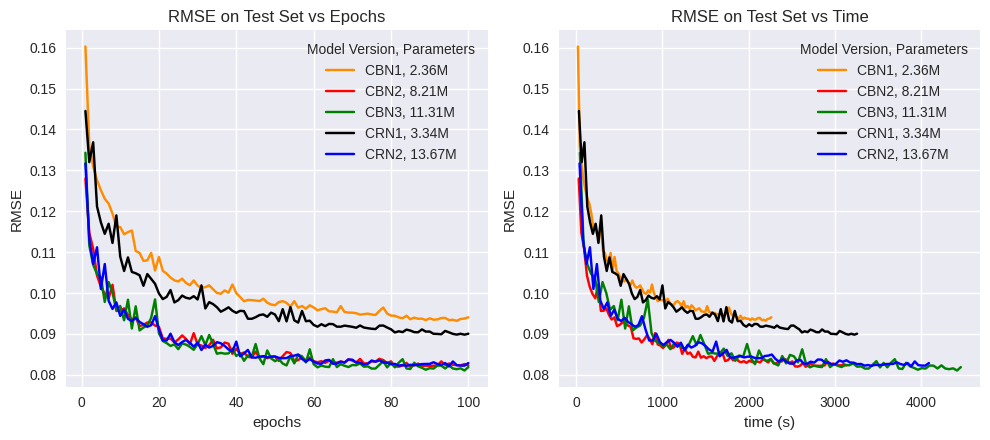

In [60]:
plt.figure(figsize = (10,4.5))
plt.subplot(1, 2, 1)  # (rows, columns, index)
plt.style.use('seaborn-v0_8')
#plt.plot(basic1['epoch'], basic1['test RMSE'], label = 'CBN1, 3.86M', color = 'green')
plt.plot(basic1['epoch'], basic1['test RMSE'], label = 'CBN1, 2.36M', color = 'darkorange')
plt.plot(basic2['epoch'], basic2['test RMSE'], label = 'CBN2, 8.21M', color = 'red')
plt.plot(basic3['epoch'], basic3['test RMSE'], label = 'CBN3, 11.31M', color = 'green')
plt.plot(res1['epoch'], res1['test RMSE'], label = 'CRN1, 3.34M', color = 'black')
plt.plot(res2['epoch'], res2['test RMSE'], label = 'CRN2, 13.67M', color = 'blue')
#plt.plot(res2test['epoch'], res2test['test RMSE'], label = 'CRN2test, 13.67M', color = 'violet')
#plt.plot(res4['epoch'], res4['test RMSE'], label = 'CRN3, 31.39M', color = 'darkorange')
#plt.plot(basicnew['epoch'], basicnew['test RMSE'], label = 'BASIC NEW1', color = 'violet')
plt.title('RMSE on Test Set vs Epochs')
plt.xlabel('epochs')
plt.ylabel('RMSE')
plt.legend(title='Model Version, Parameters')

# Second plot
plt.subplot(1, 2, 2)  # (rows, columns, index)
plt.style.use('seaborn-v0_8')
#plt.plot(basic1['time'], basic1['test RMSE'], label = 'CBN1, 3.86M', color = 'green')
plt.plot(basic1['time'], basic1['test RMSE'], label = 'CBN1, 2.36M', color = 'darkorange')
plt.plot(basic2['time'], basic2['test RMSE'], label = 'CBN2, 8.21M', color = 'red')
plt.plot(basic3['time'], basic3['test RMSE'], label = 'CBN3, 11.31M', color = 'green')
plt.plot(res1['time'], res1['test RMSE'], label = 'CRN1, 3.34M', color = 'black')
plt.plot(res2['time'], res2['test RMSE'], label = 'CRN2, 13.67M', color = 'blue')
#plt.plot(res3['time'], res3['test RMSE'], label = 'CRN2, 13.67M', color = 'pink')
#plt.plot(res2test['time'], res2test['test RMSE'], label = 'CRN2, 13.67M', color = 'violet')
#plt.plot(res4['time'], res4['test RMSE'], label = 'CRN3, 31.39M', color = 'darkorange')
#plt.plot(basicnew['time'], basicnew['test RMSE'], label = 'BASIC NEW1', color = 'violet')
plt.title('RMSE on Test Set vs Time')
plt.xlabel('time (s)')
plt.ylabel('RMSE')
plt.legend(title='Model Version, Parameters')

# Show the plot
plt.tight_layout()
plt.show()

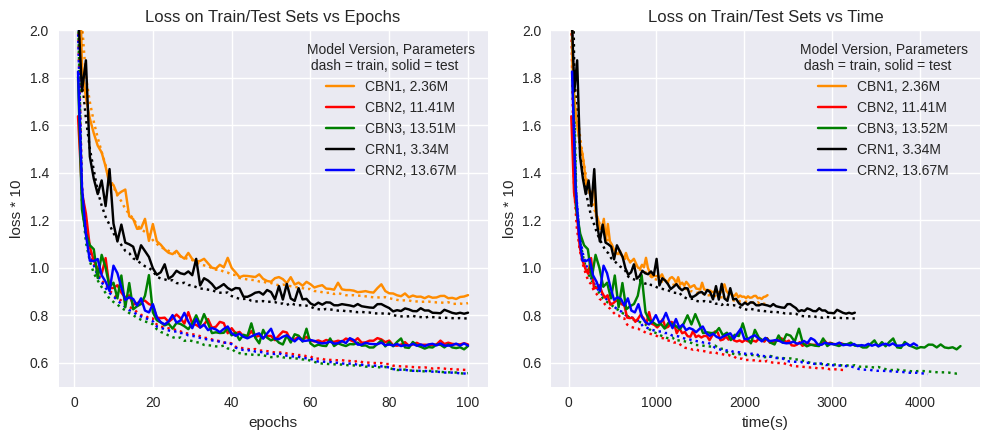

In [82]:
plt.figure(figsize = (10,4.5))
plt.subplot(1, 2, 1)  # (rows, columns, index)
plt.style.use('seaborn-v0_8')
plt.plot(basic1['epoch'], basic1['train loss']*100, linestyle = ':', color = 'darkorange')
plt.plot(basic2['epoch'], basic2['train loss']*100, linestyle = ':', color = 'red')
plt.plot(basic3['epoch'], basic3['train loss']*100, linestyle = ':', color = 'green')
plt.plot(res1['epoch'], res1['train loss']*100,  linestyle = ':', color = 'black')
plt.plot(res2['epoch'], res2['train loss']*100,  linestyle = ':', color = 'blue')
#plt.plot(res4['epoch'], res4['train loss']*100, linestyle = ':', color = 'darkorange')
plt.plot(basic1['epoch'], basic1['test loss']*100, label = 'CBN1, 2.36M', color = 'darkorange')
plt.plot(basic2['epoch'], basic2['test loss']*100, label = 'CBN2, 11.41M', color = 'red')
plt.plot(basic3['epoch'], basic3['test loss']*100, label = 'CBN3, 13.51M', color = 'green')
plt.plot(res1['epoch'], res1['test loss']*100, label = 'CRN1, 3.34M', color = 'black')
plt.plot(res2['epoch'], res3['test loss']*100, label = 'CRN2, 13.67M', color = 'blue')
#plt.plot(res4['epoch'], res4['test loss']*100, label = 'CRN3, 31.39M', color = 'darkorange')
plt.ylim((0.5,2))
plt.title('Loss on Train/Test Sets vs Epochs')
plt.xlabel('epochs')
plt.ylabel('loss * 10')
legend = plt.legend()
legend.set_title('Model Version, Parameters\n dash = train, solid = test')
plt.subplot(1, 2, 2)
plt.style.use('seaborn-v0_8')
plt.plot(basic1['time'], basic1['train loss']*100, linestyle = ':', color = 'darkorange')
plt.plot(basic2['time'], basic2['train loss']*100, linestyle = ':', color = 'red')
plt.plot(basic3['time'], basic3['train loss']*100, linestyle = ':', color = 'green')
plt.plot(res1['time'], res1['train loss']*100,  linestyle = ':', color = 'black')
plt.plot(res2['time'], res2['train loss']*100,  linestyle = ':', color = 'blue')
#plt.plot(res4['time'], res4['train loss']*100, linestyle = ':', color = 'darkorange')
plt.plot(basic1['time'], basic1['test loss']*100, label = 'CBN1, 2.36M', color = 'darkorange')
plt.plot(basic2['time'], basic2['test loss']*100, label = 'CBN2, 11.41M', color = 'red')
plt.plot(basic3['time'], basic3['test loss']*100, label = 'CBN3, 13.52M', color = 'green')
plt.plot(res1['time'], res1['test loss']*100, label = 'CRN1, 3.34M', color = 'black')
plt.plot(res3['time'], res3['test loss']*100, label = 'CRN2, 13.67M', color = 'blue')
#plt.plot(res4['time'], res4['test loss']*100, label = 'CRN3, 31.39M', color = 'darkorange')



#plt.xlim((0,100))
plt.ylim((0.5,2))
plt.title('Loss on Train/Test Sets vs Time')
plt.xlabel('time(s)')
plt.ylabel('loss * 10')

legend = plt.legend()
legend.set_title('Model Version, Parameters\n dash = train, solid = test')
plt.tight_layout()
plt.show()

In [43]:
data = pd.read_csv('training_solutions_rev1.csv')

In [44]:
data

,GalaxyID,Class1.1,Class1.2,Class1.3,Class2.1,Class2.2,Class3.1,Class3.2,Class4.1,Class4.2,...,Class9.3,Class10.1,Class10.2,Class10.3,Class11.1,Class11.2,Class11.3,Class11.4,Class11.5,Class11.6
0,100008,0.383147,0.616853,0.000000,0.000000,0.616853,0.038452,0.578401,0.418398,0.198455,...,0.000000,0.279952,0.138445,0.000000,0.000000,0.092886,0.000000,0.000000,0.0,0.325512
1,100023,0.327001,0.663777,0.009222,0.031178,0.632599,0.467370,0.165229,0.591328,0.041271,...,0.018764,0.000000,0.131378,0.459950,0.000000,0.591328,0.000000,0.000000,0.0,0.000000
2,100053,0.765717,0.177352,0.056931,0.000000,0.177352,0.000000,0.177352,0.000000,0.177352,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000
3,100078,0.693377,0.238564,0.068059,0.000000,0.238564,0.109493,0.129071,0.189098,0.049466,...,0.000000,0.094549,0.000000,0.094549,0.189098,0.000000,0.000000,0.000000,0.0,0.000000
4,100090,0.933839,0.000000,0.066161,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61573,999948,0.510379,0.489621,0.000000,0.059207,0.430414,0.000000,0.430414,0.226257,0.204157,...,0.000000,0.226257,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.226257
61574,999950,0.901216,0.098784,0.000000,0.000000,0.098784,0.000000,0.098784,0.000000,0.098784,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000
61575,999958,0.202841,0.777376,0.019783,0.116962,0.660414,0.067245,0.593168,0.140022,0.520391,...,0.000000,0.000000,0.090673,0.049349,0.000000,0.067726,0.000000,0.000000,0.0,0.072296
61576,999964,0.091000,0.909000,0.000000,0.045450,0.863550,0.022452,0.841098,0.795330,0.068220,...,0.000000,0.068398,0.318132,0.408799,0.227464,0.408799,0.090668,0.023065,0.0,0.045334


In [119]:
csv_file = 'training_solutions_rev1.csv'
image_folder = 'images_training_rev1'
data_frame = pd.read_csv(csv_file)


transform_valid = transforms.Compose([        # Random rotation between -30 and 30 degrees
    transforms.CenterCrop(size=(180, 180)),        # Center crop to 224x224
    transforms.ToTensor(),                           # Convert the image to a tensor
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Normalize
])

dataset = ImageDataset(data_frame=data_frame, image_folder=image_folder, transform=transform_valid)

loader = DataLoader(dataset, batch_size=200, shuffle=False, num_workers = 24)

model = ResNet4()
model = torch.load('RES4.pth')

# Move the model to the desired device (e.g., CPU or GPU)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.to(device)
columns = data_frame.columns[1:38]
fit = pd.DataFrame([], columns = columns)
model.eval()
records = 0
with torch.no_grad():
    for batch, (images, labels) in enumerate(tqdm(loader)):
        with torch.no_grad():
            images = images.to(device)
            outputs = model(images)
            outputs = outputs.cpu().numpy()
            records += outputs.shape[0]
            for row in outputs:
                fit.loc[len(fit)] = row
records

/tmp/ipykernel_193995/3196744587.py:17: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model = torch.load('RES4.pth')
100%|██████████| 308/308 [00:52<00:00,  5.85it/s]


61578

In [74]:
len(columns)

37

In [87]:
fit.shape

(61578, 37)

In [88]:
data_frame.shape

(61578, 38)

In [89]:
fit

,Class1.1,Class1.2,Class1.3,Class2.1,Class2.2,Class3.1,Class3.2,Class4.1,Class4.2,Class5.1,...,Class9.3,Class10.1,Class10.2,Class10.3,Class11.1,Class11.2,Class11.3,Class11.4,Class11.5,Class11.6
0,0.542645,0.472662,0.000946,-0.025022,0.485371,0.045509,0.446065,0.220598,0.275577,-0.029371,...,0.007814,0.156398,0.072064,0.001566,0.006506,0.090294,0.010688,0.016797,0.015052,0.137391
1,0.356962,0.614112,0.010720,0.310907,0.324469,0.087604,0.213296,0.110065,0.213583,0.014032,...,0.030244,0.035532,0.054425,0.033615,0.035707,0.072848,0.000695,-0.013637,-0.040157,0.070863
2,0.768513,0.205552,-0.008798,-0.017905,0.209914,-0.031942,0.247347,0.041729,0.142268,0.006317,...,-0.040795,0.010693,0.045594,0.025663,-0.018773,0.041119,0.034974,-0.010317,0.017333,0.044110
3,0.627835,0.361234,0.007944,-0.013699,0.352059,0.052647,0.288596,0.118798,0.261089,-0.006969,...,-0.025400,0.003163,0.068033,0.016054,-0.003764,0.095833,-0.013479,-0.016678,-0.009548,0.060663
4,0.717054,0.298626,0.004158,-0.029139,0.301066,0.004503,0.303953,0.056058,0.203992,0.005849,...,-0.030224,0.046513,0.049748,-0.004487,-0.033124,0.057261,-0.003350,-0.002231,0.004484,0.049005
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61573,0.511979,0.488816,0.008936,0.098121,0.341595,0.021457,0.310610,0.135657,0.241800,0.130823,...,0.049890,0.091455,0.047783,-0.004390,0.016637,0.012266,0.009917,0.014494,0.001285,0.122969
61574,0.725542,0.257796,0.027109,-0.019068,0.266400,-0.002416,0.257597,0.011816,0.240195,-0.012522,...,-0.007090,-0.006599,-0.000280,0.017199,0.002509,0.002334,0.005360,-0.014499,0.016584,0.019045
61575,0.120619,0.900113,-0.031191,0.132075,0.756670,0.249528,0.482896,0.579278,0.191986,0.080141,...,0.000776,0.110803,0.241902,0.204361,0.002243,0.416604,0.047624,-0.038987,-0.018553,0.087526
61576,0.052229,0.932345,-0.012992,0.012458,0.945007,0.216711,0.718026,0.832837,0.132443,0.066348,...,-0.011469,0.293671,0.336231,0.194007,0.026032,0.441855,0.079566,0.061218,0.114372,0.052747


In [91]:
data = data.drop('GalaxyID', axis = 1)

In [92]:
data

,Class1.1,Class1.2,Class1.3,Class2.1,Class2.2,Class3.1,Class3.2,Class4.1,Class4.2,Class5.1,...,Class9.3,Class10.1,Class10.2,Class10.3,Class11.1,Class11.2,Class11.3,Class11.4,Class11.5,Class11.6
0,0.383147,0.616853,0.000000,0.000000,0.616853,0.038452,0.578401,0.418398,0.198455,0.000000,...,0.000000,0.279952,0.138445,0.000000,0.000000,0.092886,0.000000,0.000000,0.0,0.325512
1,0.327001,0.663777,0.009222,0.031178,0.632599,0.467370,0.165229,0.591328,0.041271,0.000000,...,0.018764,0.000000,0.131378,0.459950,0.000000,0.591328,0.000000,0.000000,0.0,0.000000
2,0.765717,0.177352,0.056931,0.000000,0.177352,0.000000,0.177352,0.000000,0.177352,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000
3,0.693377,0.238564,0.068059,0.000000,0.238564,0.109493,0.129071,0.189098,0.049466,0.000000,...,0.000000,0.094549,0.000000,0.094549,0.189098,0.000000,0.000000,0.000000,0.0,0.000000
4,0.933839,0.000000,0.066161,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61573,0.510379,0.489621,0.000000,0.059207,0.430414,0.000000,0.430414,0.226257,0.204157,0.043458,...,0.000000,0.226257,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.226257
61574,0.901216,0.098784,0.000000,0.000000,0.098784,0.000000,0.098784,0.000000,0.098784,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000
61575,0.202841,0.777376,0.019783,0.116962,0.660414,0.067245,0.593168,0.140022,0.520391,0.000000,...,0.000000,0.000000,0.090673,0.049349,0.000000,0.067726,0.000000,0.000000,0.0,0.072296
61576,0.091000,0.909000,0.000000,0.045450,0.863550,0.022452,0.841098,0.795330,0.068220,0.000000,...,0.000000,0.068398,0.318132,0.408799,0.227464,0.408799,0.090668,0.023065,0.0,0.045334


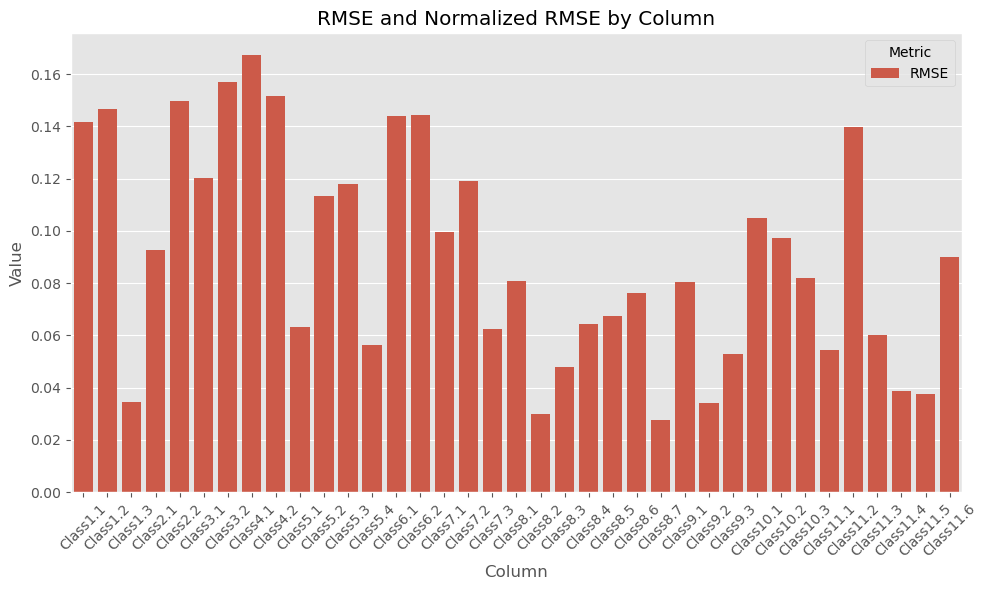

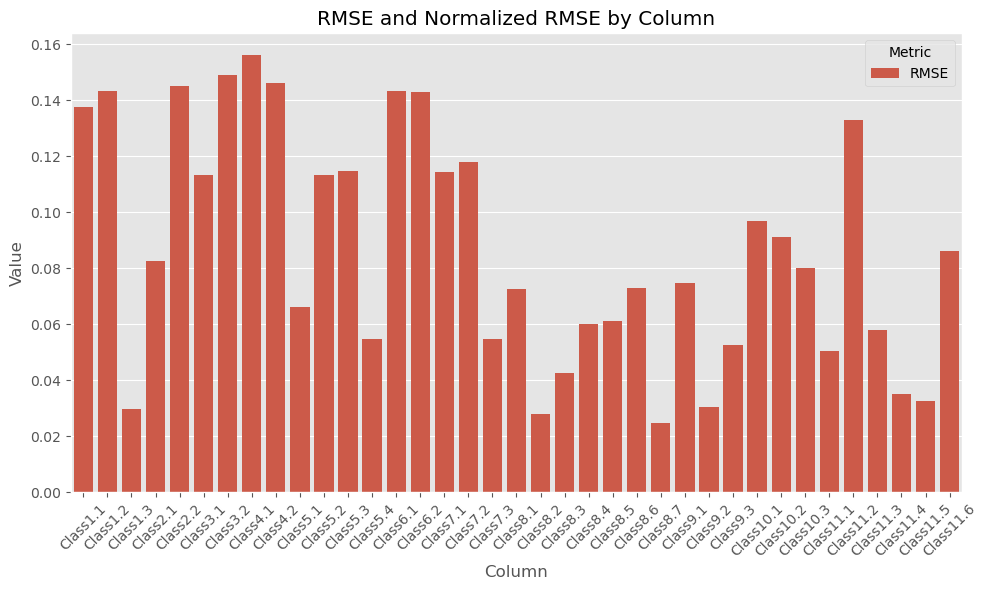

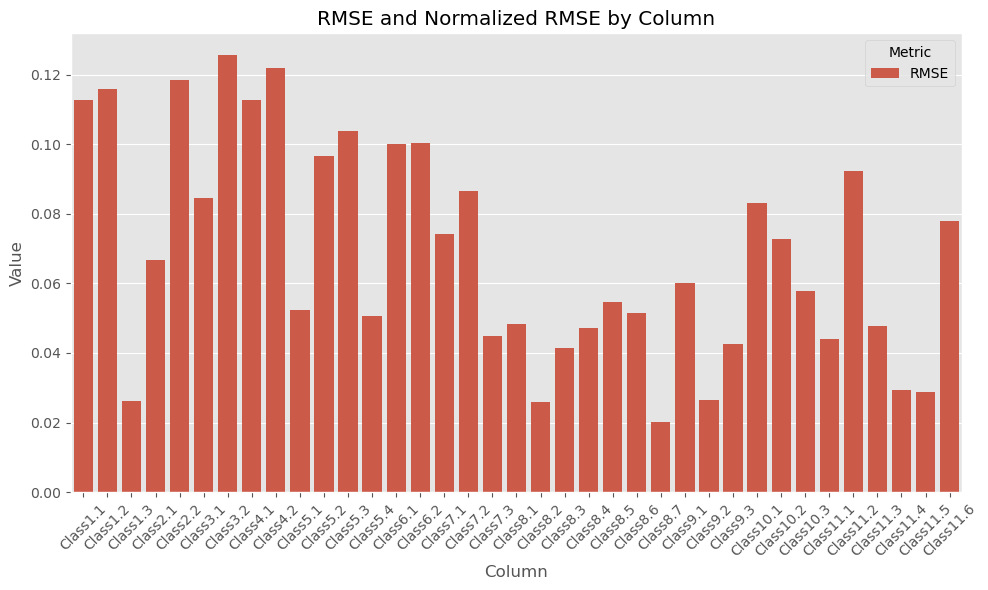

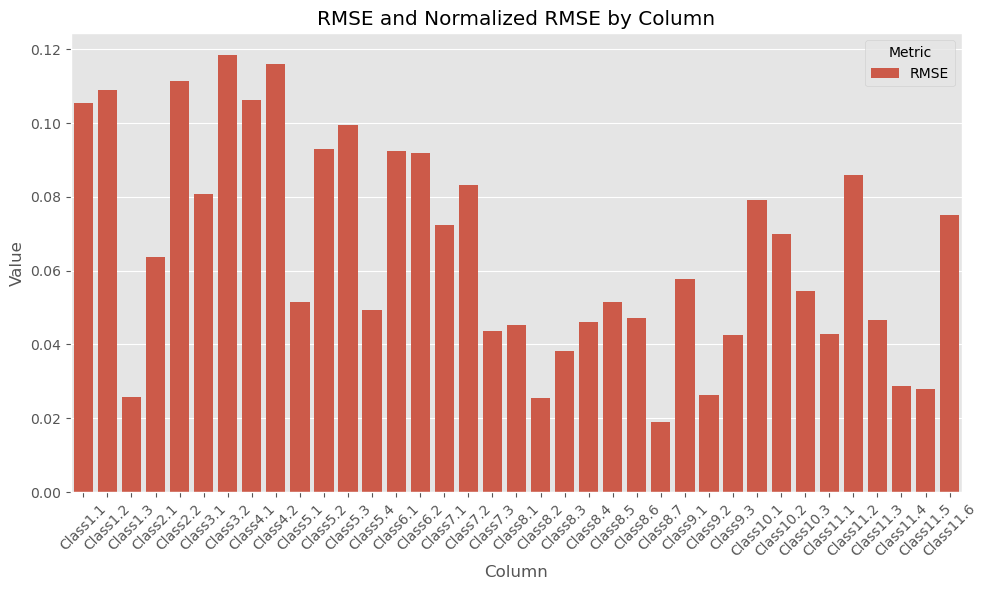

In [120]:
rmse_dict = {}
normalized_rmse_dict = {}

for column in columns:
    # Calculate RMSE
    rmse = np.sqrt(((data[column] - fit[column]) ** 2).mean())
    rmse_dict[column] = rmse
    
    # Normalized RMSE by the mean of the actual values
    mean_value = data[column].mean()
    normalized_rmse = rmse / mean_value if mean_value != 0 else np.nan
    normalized_rmse_dict[column] = normalized_rmse

# Convert to DataFrame for easy plotting
rmse_resnet4 = pd.DataFrame({
    'Metric': ['RMSE'] * len(rmse_dict),
    'Value': list(rmse_dict.values()),
    'Column': list(rmse_dict.keys())
})

# Plotting
plt.figure(figsize=(10, 6))
sns.barplot(x='Column', y='Value', hue='Metric', data=rmse_basic)

plt.title('RMSE and Normalized RMSE by Column')
plt.xlabel('Column')
plt.ylabel('Value')
plt.xticks(rotation=45)
plt.legend(title='Metric', loc='upper right')
plt.tight_layout()
plt.show()


plt.figure(figsize=(10, 6))

sns.barplot(x='Column', y='Value', hue='Metric', data=rmse_resnet2)

plt.title('RMSE and Normalized RMSE by Column')
plt.xlabel('Column')
plt.ylabel('Value')
plt.xticks(rotation=45)
plt.legend(title='Metric', loc='upper right')
plt.tight_layout()
plt.show()


plt.figure(figsize=(10, 6))

sns.barplot(x='Column', y='Value', hue='Metric', data=rmse_resnet3)
plt.title('RMSE and Normalized RMSE by Column')
plt.xlabel('Column')
plt.ylabel('Value')
plt.xticks(rotation=45)
plt.legend(title='Metric', loc='upper right')
plt.tight_layout()
plt.show()

plt.figure(figsize=(10, 6))

sns.barplot(x='Column', y='Value', hue='Metric', data=rmse_resnet4)
plt.title('RMSE and Normalized RMSE by Column')
plt.xlabel('Column')
plt.ylabel('Value')
plt.xticks(rotation=45)
plt.legend(title='Metric', loc='upper right')
plt.tight_layout()
plt.show()

In [106]:
rmse_basic

,Metric,Value,Column
0,RMSE,0.141623,Class1.1
1,RMSE,0.146654,Class1.2
2,RMSE,0.034605,Class1.3
3,RMSE,0.092872,Class2.1
4,RMSE,0.149747,Class2.2
5,RMSE,0.120378,Class3.1
6,RMSE,0.156859,Class3.2
7,RMSE,0.167280,Class4.1
8,RMSE,0.151574,Class4.2
9,RMSE,0.063189,Class5.1


In [114]:
rmse_resnet2

,Metric,Value,Column
0,RMSE,0.137646,Class1.1
1,RMSE,0.143221,Class1.2
2,RMSE,0.029672,Class1.3
3,RMSE,0.082533,Class2.1
4,RMSE,0.145058,Class2.2
5,RMSE,0.113206,Class3.1
6,RMSE,0.149122,Class3.2
7,RMSE,0.156110,Class4.1
8,RMSE,0.146347,Class4.2
9,RMSE,0.066223,Class5.1


In [124]:
rmse_total = pd.DataFrame()
rmse_total['class'] = rmse_resnet2['Column']
rmse_total['Basic RMSE'] = rmse_basic['Value']
rmse_total['Resnet2 RMSE'] = rmse_resnet2['Value']
rmse_total['ResNet3 RMSE'] = rmse_resnet3['Value']
rmse_total['ResNet4 RMSE'] = rmse_resnet4['Value']
rmse_total['dif'] = rmse_total['ResNet3 RMSE'] - rmse_total['ResNet4 RMSE']

In [125]:
rmse_total

,class,Basic RMSE,Resnet2 RMSE,ResNet3 RMSE,ResNet4 RMSE,dif
0,Class1.1,0.141623,0.137646,0.112677,0.105537,0.007140
1,Class1.2,0.146654,0.143221,0.115828,0.108952,0.006876
2,Class1.3,0.034605,0.029672,0.026278,0.025639,0.000639
3,Class2.1,0.092872,0.082533,0.066784,0.063833,0.002952
4,Class2.2,0.149747,0.145058,0.118532,0.111480,0.007052
5,Class3.1,0.120378,0.113206,0.084430,0.080779,0.003651
6,Class3.2,0.156859,0.149122,0.125608,0.118396,0.007211
7,Class4.1,0.167280,0.156110,0.112696,0.106141,0.006555
8,Class4.2,0.151574,0.146347,0.122047,0.116125,0.005922
9,Class5.1,0.063189,0.066223,0.052414,0.051626,0.000787


In [192]:
csv_file = 'training_solutions_rev1.csv'
fit_data = pd.read_csv(csv_file)

In [193]:
fit_data

,GalaxyID,Class1.1,Class1.2,Class1.3,Class2.1,Class2.2,Class3.1,Class3.2,Class4.1,Class4.2,...,Class9.3,Class10.1,Class10.2,Class10.3,Class11.1,Class11.2,Class11.3,Class11.4,Class11.5,Class11.6
0,100008,0.383147,0.616853,0.000000,0.000000,0.616853,0.038452,0.578401,0.418398,0.198455,...,0.000000,0.279952,0.138445,0.000000,0.000000,0.092886,0.000000,0.000000,0.0,0.325512
1,100023,0.327001,0.663777,0.009222,0.031178,0.632599,0.467370,0.165229,0.591328,0.041271,...,0.018764,0.000000,0.131378,0.459950,0.000000,0.591328,0.000000,0.000000,0.0,0.000000
2,100053,0.765717,0.177352,0.056931,0.000000,0.177352,0.000000,0.177352,0.000000,0.177352,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000
3,100078,0.693377,0.238564,0.068059,0.000000,0.238564,0.109493,0.129071,0.189098,0.049466,...,0.000000,0.094549,0.000000,0.094549,0.189098,0.000000,0.000000,0.000000,0.0,0.000000
4,100090,0.933839,0.000000,0.066161,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61573,999948,0.510379,0.489621,0.000000,0.059207,0.430414,0.000000,0.430414,0.226257,0.204157,...,0.000000,0.226257,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.226257
61574,999950,0.901216,0.098784,0.000000,0.000000,0.098784,0.000000,0.098784,0.000000,0.098784,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000
61575,999958,0.202841,0.777376,0.019783,0.116962,0.660414,0.067245,0.593168,0.140022,0.520391,...,0.000000,0.000000,0.090673,0.049349,0.000000,0.067726,0.000000,0.000000,0.0,0.072296
61576,999964,0.091000,0.909000,0.000000,0.045450,0.863550,0.022452,0.841098,0.795330,0.068220,...,0.000000,0.068398,0.318132,0.408799,0.227464,0.408799,0.090668,0.023065,0.0,0.045334


/tmp/ipykernel_899904/2057378737.py:4: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


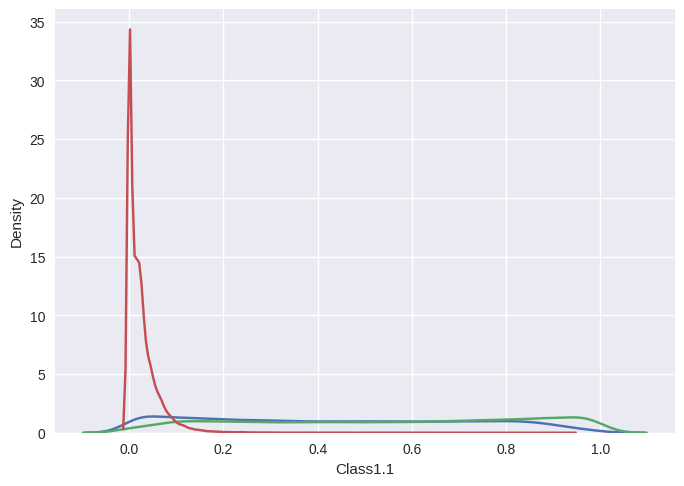

In [197]:
sns.kdeplot(fit_data['Class1.1'])
sns.kdeplot(fit_data['Class1.2'])
sns.kdeplot(fit_data['Class1.3'])
plt.legend()

In [198]:
data_1 = fit_data[['Class1.1', 'Class1.2', 'Class1.3']]

<Axes: >

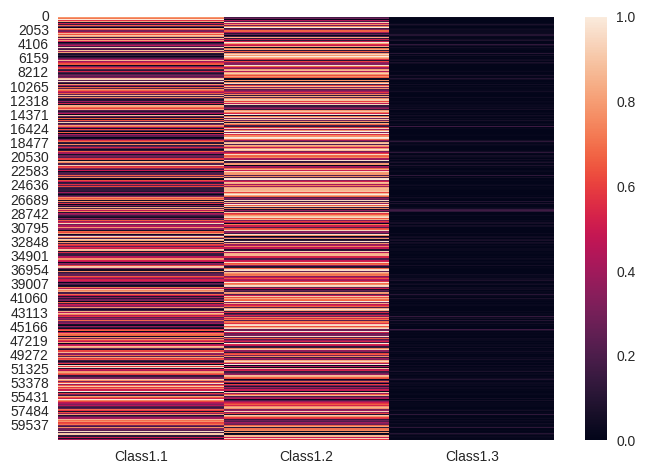

In [199]:
sns.heatmap(data_1)

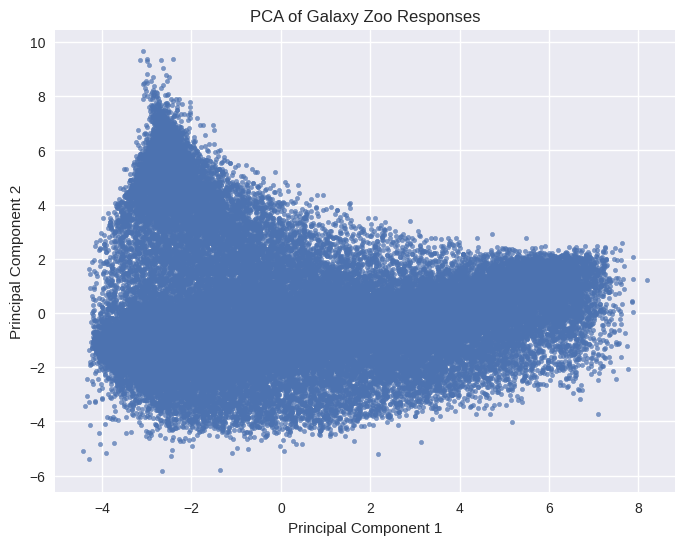

In [211]:
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

# Load your dataset (assuming it's a CSV file)
data = pd.read_csv(csv_file)
data = data.drop('GalaxyID', axis = 1)
# Assuming your dataset has 37 columns representing the response probabilities
X = data.values  # Convert to NumPy array for PCA

# Standardize the data
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Apply PCA
pca = PCA(n_components=10)  # Reduce to 2 dimensions for visualization
X_pca = pca.fit_transform(X_scaled)

# Plot the results
plt.figure(figsize=(8, 6))
plt.scatter(X_pca[:, 0], X_pca[:, 1], s=10, alpha=0.7)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('PCA of Galaxy Zoo Responses')
plt.show()

/home/cualum/anaconda3/envs/myenv/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:1162: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


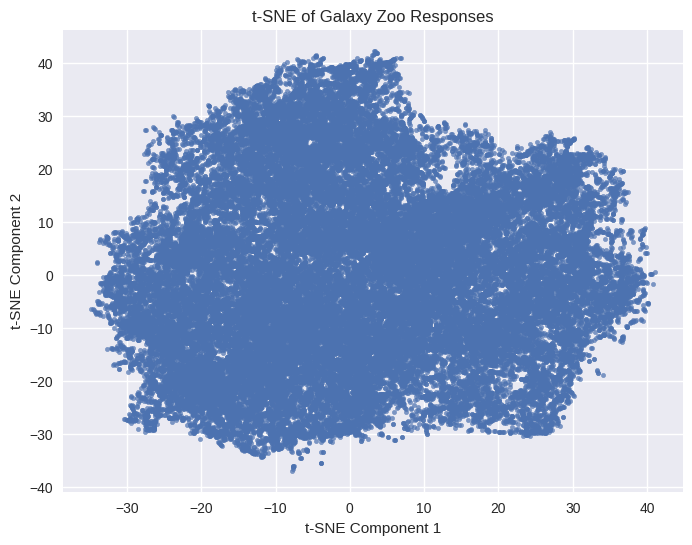

In [212]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=3, random_state=42, perplexity=30, n_iter=1000)
X_tsne = tsne.fit_transform(X_scaled)

plt.figure(figsize=(8, 6))
plt.scatter(X_tsne[:, 0], X_tsne[:, 1], s=10, alpha=0.7)
plt.xlabel('t-SNE Component 1')
plt.ylabel('t-SNE Component 2')
plt.title('t-SNE of Galaxy Zoo Responses')
plt.show()

In [204]:
import graphviz

# Create a new directed graph for the decision tree
dot = graphviz.Digraph(comment='Galaxy Zoo Decision Tree')

# Add nodes for each question (Q1 to Q11)
dot.node('Q1', 'Q1: Is the object a smooth galaxy, a galaxy with features/disk, or a star?')
dot.node('Q2', 'Q2: Is it edge-on?')
dot.node('Q3', 'Q3: Is there a bar?')
dot.node('Q4', 'Q4: Is there a spiral pattern?')
dot.node('Q5', 'Q5: How prominent is the central bulge?')
dot.node('Q6', 'Q6: Is there anything "odd" about the galaxy?')
dot.node('Q7', 'Q7: How round is the smooth galaxy?')
dot.node('Q8', 'Q8: What is the odd feature?')
dot.node('Q9', 'Q9: What shape is the bulge in the edge-on galaxy?')
dot.node('Q10', 'Q10: How tightly wound are the spiral arms?')
dot.node('Q11', 'Q11: How many spiral arms are there?')

# Add edges between nodes, representing paths in the decision tree with probabilities

# Q1 leads to Q2, Q3, Q4 based on "smooth", "features/disk", and "star/artifact" responses
dot.edge('Q1', 'Q2', label='Smooth (0.80), Features/Disk (0.15), Star (0.05)')

# For Smooth: Q2 leads to further questions like Q7, Q5 (How round, How prominent the bulge)
dot.edge('Q2', 'Q7', label='Edge-on (0.60), Not Edge-on (0.40)')

# For Features/Disk: This leads to another set of questions (e.g., Q4 for spiral)
dot.edge('Q1', 'Q4', label='Features/Disk (0.15), Spiral Pattern (0.50), Bar (0.35)')

# Q7 represents questions about the roundness of the galaxy in smooth classification
dot.edge('Q7', 'Q5', label='Completely Round (0.40), In-between (0.25), Cigar-shaped (0.25)')

# More edges can be added for other questions following similar logic
dot.edge('Q5', 'Q6', label='Bulge prominent (0.70), Bulge not prominent (0.30)')

# Q6 answers lead to classification details, such as odd features (Q8)
dot.edge('Q6', 'Q8', label='Odd Feature (0.10), No Odd Feature (0.90)')

# Repeat for the other questions (Q8, Q9, Q10, etc.)

# Final classification results are implied at leaf nodes (not shown in this code snippet)

# Render the decision tree and view the result
dot.render('galaxy_zoo_decision_tree', format='png', view=True)

'galaxy_zoo_decision_tree.png'

/home/cualum/anaconda3/envs/myenv/lib/python3.9/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


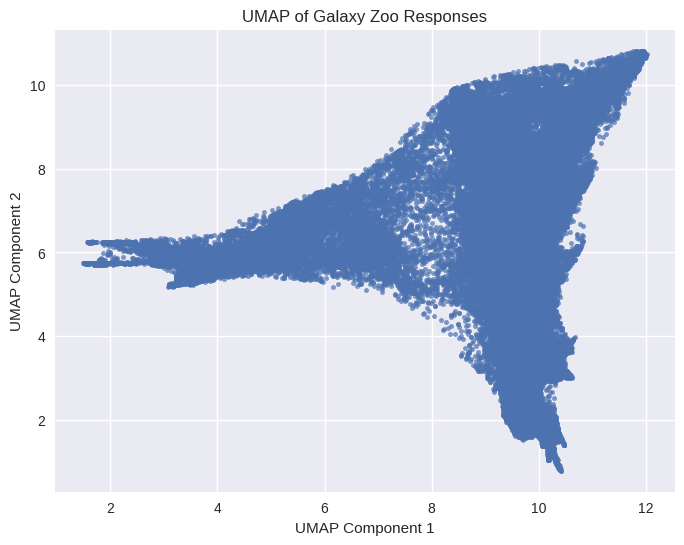

In [209]:
import umap

reducer = umap.UMAP(n_components=3, random_state=42)
X_umap = reducer.fit_transform(X_scaled)

plt.figure(figsize=(8, 6))
plt.scatter(X_umap[:, 0], X_umap[:, 1], s=10, alpha=0.7)
plt.xlabel('UMAP Component 1')
plt.ylabel('UMAP Component 2')
plt.title('UMAP of Galaxy Zoo Responses')
plt.show()

<Axes: >

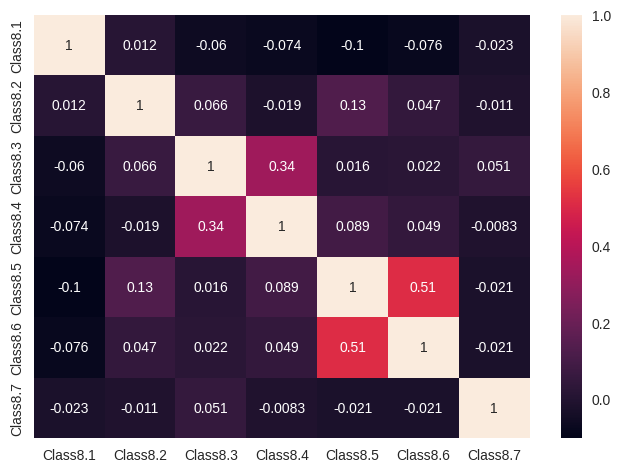

In [222]:
corr = data[['Class8.1', 'Class8.2', 'Class8.3', 'Class8.4', 'Class8.5', 'Class8.6', 'Class8.7']].corr()
sns.heatmap(corr, annot = True)

<Axes: >

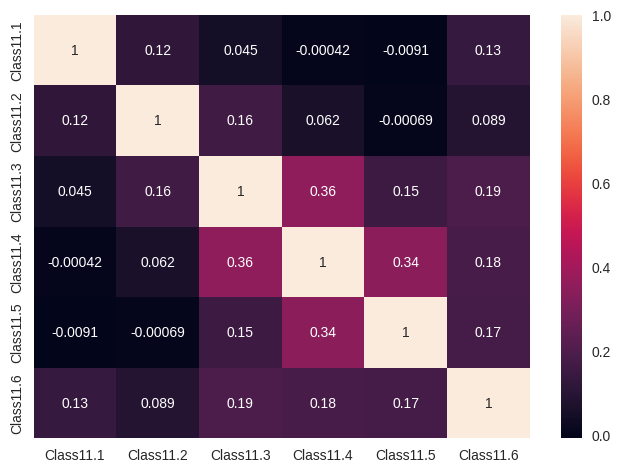

In [307]:
corr = data[['Class11.1', 'Class11.2', 'Class11.3', 'Class11.4', 'Class11.5', 'Class11.6']].corr()
sns.heatmap(corr, annot = True)

<Axes: >

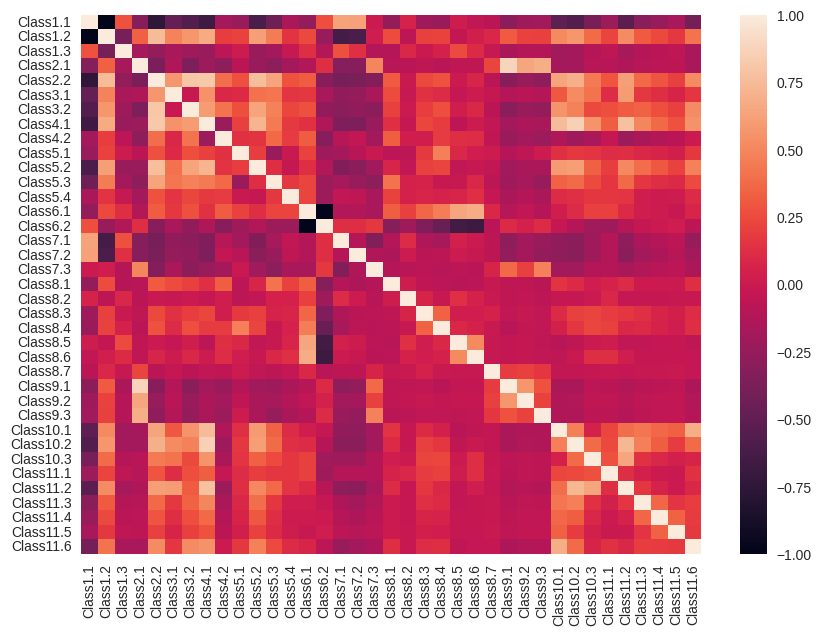

In [231]:
plt.figure(figsize = (10,7))
corr = data.drop('Cluster', axis = 1).corr()
sns.heatmap(corr, square = False)



In [232]:
corr

,Class1.1,Class1.2,Class1.3,Class2.1,Class2.2,Class3.1,Class3.2,Class4.1,Class4.2,Class5.1,...,Class9.3,Class10.1,Class10.2,Class10.3,Class11.1,Class11.2,Class11.3,Class11.4,Class11.5,Class11.6
Class1.1,1.000000,-0.992416,0.280863,-0.324072,-0.746400,-0.481550,-0.564992,-0.670888,-0.187805,-0.229011,...,-0.200730,-0.508271,-0.568344,-0.384315,-0.223538,-0.518724,-0.308240,-0.234735,-0.166207,-0.404101
Class1.2,-0.992416,1.000000,-0.396710,0.332616,0.747833,0.481963,0.566443,0.671806,0.188752,0.218291,...,0.206699,0.512074,0.568195,0.381616,0.221152,0.518735,0.307934,0.234663,0.166432,0.407822
Class1.3,0.280863,-0.396710,1.000000,-0.176915,-0.265020,-0.166986,-0.203469,-0.235320,-0.071268,0.005816,...,-0.114871,-0.202544,-0.192115,-0.109625,-0.057388,-0.176487,-0.102430,-0.079270,-0.058281,-0.166477
Class2.1,-0.324072,0.332616,-0.176915,1.000000,-0.377346,-0.140077,-0.359635,-0.219080,-0.285599,-0.080338,...,0.682327,-0.189016,-0.185096,-0.092647,-0.096486,-0.140464,-0.100969,-0.075473,-0.067365,-0.168409
Class2.2,-0.746400,0.747833,-0.265020,-0.377346,1.000000,0.571890,0.809411,0.813928,0.386405,0.270914,...,-0.277362,0.635910,0.688260,0.439961,0.285091,0.608272,0.373465,0.283567,0.210857,0.519029
Class3.1,-0.481550,0.481963,-0.166986,-0.140077,0.571890,1.000000,-0.018839,0.549446,0.087674,0.099202,...,-0.113586,0.298747,0.516972,0.413607,0.114720,0.597296,0.165413,0.121268,0.067495,0.156307
Class3.2,-0.564992,0.566443,-0.203469,-0.359635,0.809411,-0.018839,1.000000,0.598692,0.408190,0.259177,...,-0.256739,0.561189,0.468774,0.240141,0.265346,0.313783,0.336768,0.258801,0.208677,0.520701
Class4.1,-0.670888,0.671806,-0.235320,-0.219080,0.813928,0.549446,0.598692,1.000000,-0.221336,0.201213,...,-0.154170,0.754458,0.858094,0.562080,0.324399,0.781067,0.494255,0.370894,0.275108,0.553689
Class4.2,-0.187805,0.188752,-0.071268,-0.285599,0.386405,0.087674,0.408190,-0.221336,1.000000,0.135310,...,-0.220818,-0.130335,-0.206993,-0.153837,-0.036460,-0.218973,-0.157777,-0.112835,-0.082815,-0.007794
Class5.1,-0.229011,0.218291,0.005816,-0.080338,0.270914,0.099202,0.259177,0.201213,0.135310,1.000000,...,0.005157,0.130885,0.164744,0.154671,0.114245,0.122023,0.091713,0.066294,0.037841,0.164850


In [225]:
from sklearn.cluster import KMeans
import numpy as np

# Assuming 'df' contains the probability distributions of each galaxy
kmeans = KMeans(n_clusters=5, random_state=42)  # Try different values of K
clusters = kmeans.fit_predict(data)

# Add cluster labels to your dataframe
data['Cluster'] = clusters

# Optional: visualize clusters (e.g., with PCA)

In [226]:
cluster_means = data.groupby('Cluster').mean()
print(cluster_means)

         Class1.1  Class1.2  Class1.3  Class2.1  Class2.2  Class3.1  Class3.2  \
Cluster                                                                         
0        0.765675  0.192396  0.041929  0.020556  0.171840  0.019642  0.152198   
1        0.082651  0.908216  0.009132  0.032592  0.875624  0.291948  0.583676   
2        0.267064  0.703166  0.029769  0.049507  0.653660  0.145784  0.507875   
3        0.403177  0.577269  0.019554  0.056039  0.521230  0.094495  0.426735   
4        0.245626  0.744319  0.010056  0.632133  0.112186  0.027194  0.084992   

         Class4.1  Class4.2  Class5.1  ...  Class9.3  Class10.1  Class10.2  \
Cluster                                ...                                   
0        0.031526  0.140314  0.014444  ...  0.004178   0.015576   0.010753   
1        0.746283  0.129342  0.065574  ...  0.008363   0.292197   0.313745   
2        0.212716  0.440944  0.083749  ...  0.011725   0.081661   0.076407   
3        0.173666  0.347563  0.047033  ...

In [228]:
plt.scatter(pca_result[:, 0], pca_result[:, 1], c=df['Cluster'], cmap='viridis')
plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], c='red', marker='x')  # Plot centroids
plt.title('Galaxy Clusters with K-means Centroids')
plt.show()

NameError: name 'pca_result' is not defined

In [233]:
data_root = data[['Class1.1', 'Class1.2', 'Class1.3']]

In [234]:
data_root

,Class1.1,Class1.2,Class1.3
0,0.383147,0.616853,0.000000
1,0.327001,0.663777,0.009222
2,0.765717,0.177352,0.056931
3,0.693377,0.238564,0.068059
4,0.933839,0.000000,0.066161
...,...,...,...
61573,0.510379,0.489621,0.000000
61574,0.901216,0.098784,0.000000
61575,0.202841,0.777376,0.019783
61576,0.091000,0.909000,0.000000


In [235]:
data_root['max_label'] = data_root.idxmax(axis = 1)

/tmp/ipykernel_899904/402287477.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_root['max_label'] = data_root.idxmax(axis = 1)


In [236]:
data_root

,Class1.1,Class1.2,Class1.3,max_label
0,0.383147,0.616853,0.000000,Class1.2
1,0.327001,0.663777,0.009222,Class1.2
2,0.765717,0.177352,0.056931,Class1.1
3,0.693377,0.238564,0.068059,Class1.1
4,0.933839,0.000000,0.066161,Class1.1
...,...,...,...,...
61573,0.510379,0.489621,0.000000,Class1.1
61574,0.901216,0.098784,0.000000,Class1.1
61575,0.202841,0.777376,0.019783,Class1.2
61576,0.091000,0.909000,0.000000,Class1.2


In [237]:
map = {'Class1.1':'Smooth', 'Class1.2':'Features', 'Class1.3':'Other'}
data_root['label'] = data_root['max_label'].map(map)

/tmp/ipykernel_899904/3488627365.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_root['label'] = data_root['max_label'].map(map)


In [239]:
data_root

,Class1.1,Class1.2,Class1.3,max_label,label
0,0.383147,0.616853,0.000000,Class1.2,Features
1,0.327001,0.663777,0.009222,Class1.2,Features
2,0.765717,0.177352,0.056931,Class1.1,Smooth
3,0.693377,0.238564,0.068059,Class1.1,Smooth
4,0.933839,0.000000,0.066161,Class1.1,Smooth
...,...,...,...,...,...
61573,0.510379,0.489621,0.000000,Class1.1,Smooth
61574,0.901216,0.098784,0.000000,Class1.1,Smooth
61575,0.202841,0.777376,0.019783,Class1.2,Features
61576,0.091000,0.909000,0.000000,Class1.2,Features


<Axes: xlabel='label', ylabel='count'>

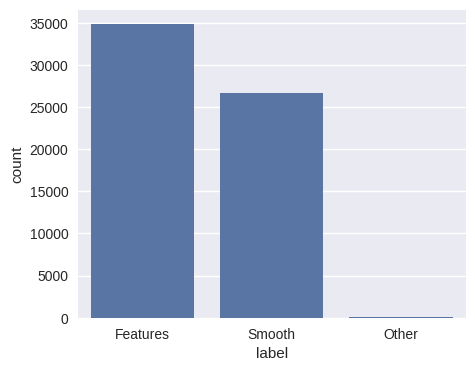

In [249]:
plt.figure(figsize = (5,4))
data_root['label'].value_counts()

In [269]:
data_root_50 = data_root[(data_root['Class1.1'] > 0.5) | (data_root['Class1.2'] > 0.5) | (data_root['Class1.3'] > 0.5)]
data_root_75 = data_root[(data_root['Class1.1'] > 0.75) | (data_root['Class1.2'] > 0.75) | (data_root['Class1.3'] > 0.75)]
data_root_50_values = data_root_50['label'].value_counts()
data_root_values = data_root['label'].value_counts()
data_root_75_values = data_root_75['label'].value_counts()

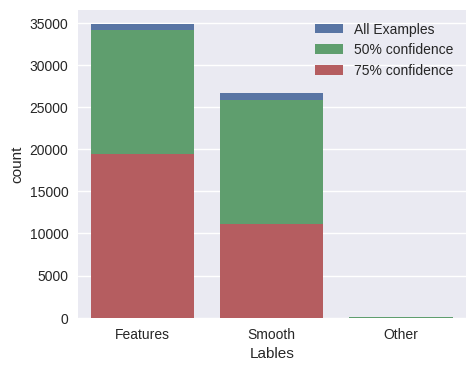

In [298]:

plt.figure(figsize = (5,4))
sns.barplot(data_root_values, label = 'All Examples')
sns.barplot(data_root_50_values, label = '50% confidence')
sns.barplot(data_root_75_values, label = '75% confidence')
plt.xlabel('Lables')
plt.legend()
plt.show()

In [244]:
data_root['label'].value_counts()

label
Features    34826
Smooth      26693
Other          59
Name: count, dtype: int64

<Axes: xlabel='Class1.1', ylabel='Count'>

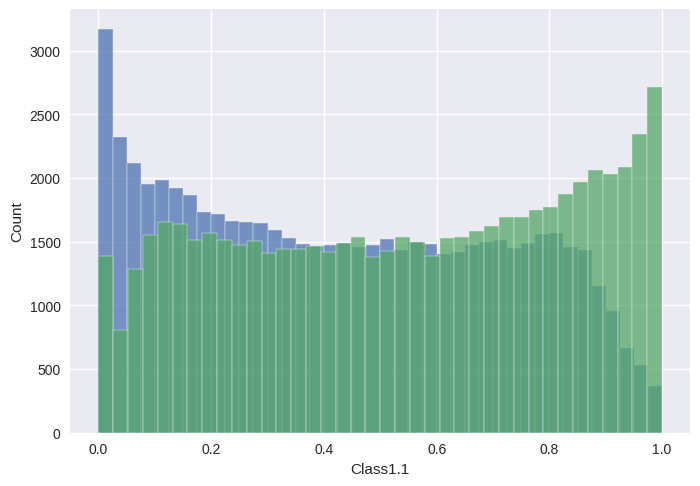

In [275]:
sns.histplot(data_root['Class1.1'])
sns.histplot(data_root['Class1.2'])
#sns.histplot(data_root['Class1.3'])

In [277]:
data_root['max_value'] = data_root[['Class1.1', 'Class1.2', 'Class1.3']].max(axis=1)

/tmp/ipykernel_899904/3543981712.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_root['max_value'] = data_root[['Class1.1', 'Class1.2', 'Class1.3']].max(axis=1)


Text(0.5, 0, 'Confidence')

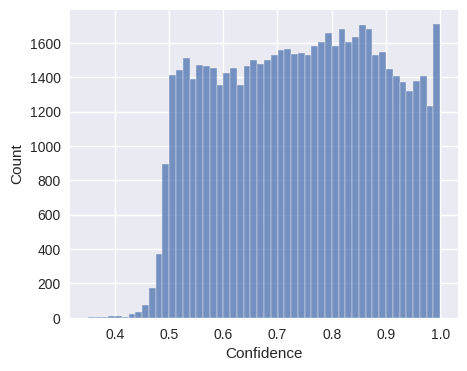

In [299]:
plt.figure(figsize = (5,4))
sns.histplot(data_root['max_value'])
plt.xlabel('Confidence')

In [301]:
data_arms = data[['Class11.1', 'Class11.2', 'Class11.3', 'Class11.4', 'Class11.5', 'Class11.6']]

In [302]:
data_arms['max_value'] = data_arms.max(axis=1)

/tmp/ipykernel_899904/2596851648.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_arms['max_value'] = data_arms.max(axis=1)


In [303]:
data_arms

,Class11.1,Class11.2,Class11.3,Class11.4,Class11.5,Class11.6,max_value
0,0.000000,0.092886,0.000000,0.000000,0.0,0.325512,0.325512
1,0.000000,0.591328,0.000000,0.000000,0.0,0.000000,0.591328
2,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000
3,0.189098,0.000000,0.000000,0.000000,0.0,0.000000,0.189098
4,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000
...,...,...,...,...,...,...,...
61573,0.000000,0.000000,0.000000,0.000000,0.0,0.226257,0.226257
61574,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000
61575,0.000000,0.067726,0.000000,0.000000,0.0,0.072296,0.072296
61576,0.227464,0.408799,0.090668,0.023065,0.0,0.045334,0.408799


In [305]:
data_arms = data_arms.drop(data_arms[data_arms['max_value'] == 0].index)

Text(0.5, 0, 'Confidence')

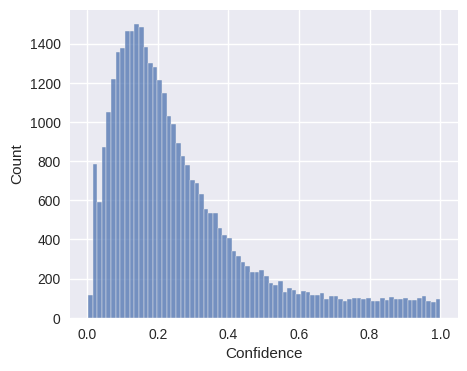

In [306]:
plt.figure(figsize = (5,4))
sns.histplot(data_arms['max_value'])
plt.xlabel('Confidence')

In [61]:
model_load_path = "BASICNEW2.pth"
model = torch.load(model_load_path)
model.eval() 

/tmp/ipykernel_2940405/2853615420.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model = torch.load(model_load_path)


BasicNetwork_new2(
  (conv1): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (bn1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv2): Conv2d(32, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv3): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv4): Conv2d(128, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (bn4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv5): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn5): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv6): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (bn6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True

In [62]:
transform = transforms.Compose([        # Random rotation between -30 and 30 degrees
    transforms.CenterCrop(size=(180, 180)),        # Center crop to 224x224
    transforms.ToTensor(),                           # Convert the image to a tensor
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Normalize
])

class ImageDataset(Dataset):
    def __init__(self, data_frame, image_folder, transform=None):
        self.data_frame = data_frame
        self.image_folder = image_folder  # Folder containing images
        self.transform = transform

    def __len__(self):
        return len(self.data_frame)

    def __getitem__(self, idx):
        img_name = str(self.data_frame.iloc[idx, 0]) + '.jpg'  # Assuming the first column is the image name
        label = self.data_frame.iloc[idx, 1:38].values  # Assuming labels are in columns 1 to 37

        img_path = os.path.join(self.image_folder, img_name)  # Construct full path
        img = Image.open(img_path)

        if self.transform:
            img = self.transform(img)

        label = torch.tensor(label, dtype=torch.float)  # Convert to tensor
        return img_name, img, label

In [63]:
csv_file = 'training_solutions_rev1.csv'
img_folder = 'images_training_rev1'
data_frame = pd.read_csv(csv_file)

# Dataset and DataLoader
dataset = ImageDataset(data_frame, img_folder, transform=transform)
dataloader = DataLoader(dataset, batch_size=1, shuffle=False)

In [64]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

results = []
  # If using RMSE as metric

with torch.no_grad():
    for image_names, images, labels in tqdm(dataloader):
        images = images.to(device)
        labels = labels.to(device).float()

        # Forward pass
        outputs = model(images)

        
        # Compute RMSE
        squared_diff = (outputs-labels)**2
        rmse_per_sample = torch.sqrt(squared_diff.mean(dim=1))

        
        # Save outputs and RMSE for analysis
        results.append([image_names[0], rmse_per_sample.cpu().numpy()[0]])

100%|██████████| 61578/61578 [02:07<00:00, 481.86it/s]


In [65]:
pd.set_option('display.max_rows', 500)
results_df = pd.DataFrame(results, columns = ['image name', 'rmse_per_sample']).sort_values(by = 'rmse_per_sample', ascending = False)
display(results_df.head(100))

,image name,rmse_per_sample
53698,882887.jpg,0.260204
40946,696736.jpg,0.254971
14984,321877.jpg,0.253292
13640,302464.jpg,0.249681
25646,474813.jpg,0.248902
696,110313.jpg,0.240693
2202,132781.jpg,0.240395
27933,509428.jpg,0.233699
38903,667610.jpg,0.232797
58240,951012.jpg,0.232674


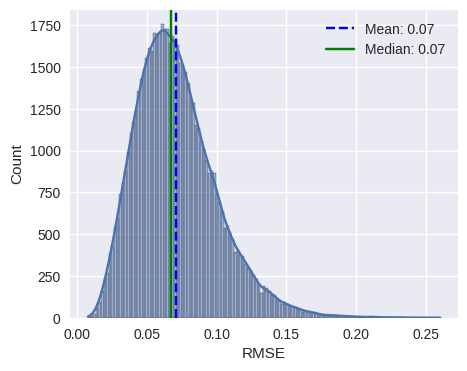

In [78]:
plt.figure(figsize=(5, 4))
plt.style.use('seaborn-v0_8')

# Plot histogram with KDE
sns.histplot(results_df['rmse_per_sample'], kde=True)
plt.xlabel('RMSE')

# Calculate mean and median
mean_rmse = results_df['rmse_per_sample'].mean()
median_rmse = results_df['rmse_per_sample'].median()

# Add vertical lines for mean and median
plt.axvline(mean_rmse, color='blue', linestyle='--', label=f'Mean: {mean_rmse:.2f}')
plt.axvline(median_rmse, color='green', linestyle='-', label=f'Median: {median_rmse:.2f}')

# Add legend
plt.legend()

# Show plot
plt.show()

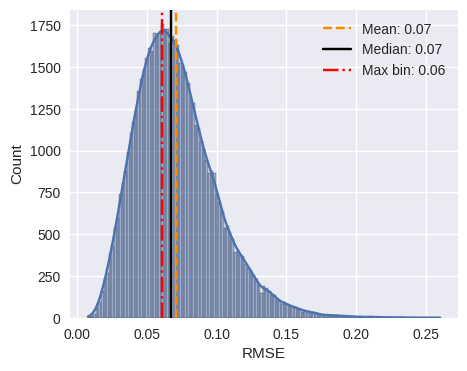

In [81]:
plt.figure(figsize=(5, 4))
plt.style.use('seaborn-v0_8')

# Plot histogram with KDE
ax = sns.histplot(results_df['rmse_per_sample'], kde=True)
plt.xlabel('RMSE')

# Calculate mean, median, and the max of the histogram
mean_rmse = results_df['rmse_per_sample'].mean()
median_rmse = results_df['rmse_per_sample'].median()

# Find the bin with the maximum frequency
max_bin_height = max([patch.get_height() for patch in ax.patches])
max_bin_index = np.argmax([patch.get_height() for patch in ax.patches])
max_bin_center = ax.patches[max_bin_index].get_x() + ax.patches[max_bin_index].get_width() / 2

# Add vertical lines for mean and median
plt.axvline(mean_rmse, color='darkorange', linestyle='--', label=f'Mean: {mean_rmse:.2f}')
plt.axvline(median_rmse, color='black', linestyle='-', label=f'Median: {median_rmse:.2f}')

# Add a vertical line for the max bin
plt.axvline(max_bin_center, color='red', linestyle='-.', label=f'Max bin: {max_bin_center:.2f}')

# Add legend
plt.legend()

# Show plot
plt.show()

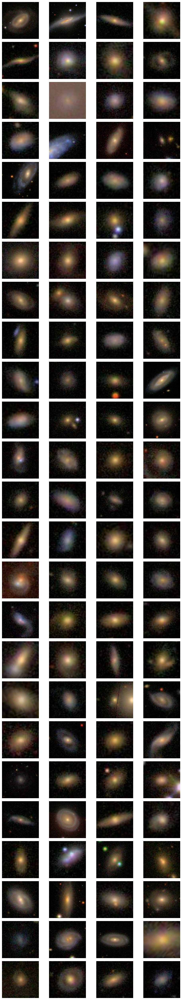

(180, 180)


In [67]:
from PIL import Image
import matplotlib.pyplot as plt

images = []
sizes = []
channels = []
cropped_images = []
cropped_sizes = []  # To store the sizes of cropped images
crop_percent = 0.4  # Crop to 40% of the original size

# Load and crop images
for image in results_df['image name'][:100]:
    img = Image.open('images_training_rev1/'+image)
    images.append(img)
    sizes.append(img.size)
    channels.append(img.mode)

    # Crop the image to 180x180 from the center
    width, height = img.size
    left = (width - 180) / 2
    top = (height - 180) / 2
    right = (width + 180) / 2
    bottom = (height + 180) / 2

    cropped_img = img.crop((left, top, right, bottom))
    cropped_images.append(cropped_img)
    cropped_sizes.append(cropped_img.size)

# Display the cropped images
plt.figure(figsize=(10, 50))
for i, cropped_img in enumerate(cropped_images):
    plt.subplot(25, 4, i + 1)  # Create a grid for display
    plt.imshow(cropped_img)
    plt.axis('off')  # Hide axes
plt.tight_layout()
plt.show()

# Optionally, print the size of the last cropped image
print(cropped_images[-1].size)

In [ ]:
plt.figure(figsize=(15, 50))  # Adjust the figure size for better readability

for i, (img, cropped_img) in enumerate(zip(images, cropped_images)):
    # Display uncropped image
    plt.subplot(25, 8, 2*i + 1)  # Odd index for uncropped image
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"Uncropped {i+1}")
    
    # Display cropped image
    plt.subplot(25, 8, 2*i + 2)  # Even index for cropped image
    plt.imshow(cropped_img)
    plt.axis('off')
    plt.title(f"Cropped {i+1}")

plt.tight_layout()
plt.show()

In [ ]:
plt.figure(figsize=(8, 400))  # Adjust the figure size for 4 wide and 100 tall layout

# Define the number of rows and columns
rows = 100
cols = 4

for i, (img, cropped_img) in enumerate(zip(images, cropped_images)):
    # Display uncropped image
    plt.subplot(rows * 2, cols, 2 * i + 1)  # Odd index for uncropped image
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"Uncropped {i+1}", fontsize=8)
    
    # Display cropped image
    plt.subplot(rows * 2, cols, 2 * i + 2)  # Even index for cropped image
    plt.imshow(cropped_img)
    plt.axis('off')
    plt.title(f"Cropped {i+1}", fontsize=8)
plt.text(
plt.tight_layout()
plt.show()

In [83]:
results_df_ascend = results_df.sort_values(by = 'rmse_per_sample', ascending = True)

In [ ]:
from PIL import Image
import matplotlib.pyplot as plt

images = []
sizes = []
channels = []
cropped_images = []
cropped_sizes = []  # To store the sizes of cropped images
crop_percent = 0.4  # Crop to 40% of the original size

# Load and crop images
for image in results_df_ascend['image name'][:100]:
    img = Image.open('images_training_rev1/'+image)
    images.append(img)
    sizes.append(img.size)
    channels.append(img.mode)

    # Crop the image to 180x180 from the center
    width, height = img.size
    left = (width - 180) / 2
    top = (height - 180) / 2
    right = (width + 180) / 2
    bottom = (height + 180) / 2

    cropped_img = img.crop((left, top, right, bottom))
    cropped_images.append(cropped_img)
    cropped_sizes.append(cropped_img.size)

# Display the cropped images
plt.figure(figsize=(10, 50))
for i, cropped_img in enumerate(cropped_images):
    plt.subplot(25, 4, i + 1)  # Create a grid for display
    plt.imshow(cropped_img)
    plt.axis('off')  # Hide axes
plt.tight_layout()
plt.show()

# Optionally, print the size of the last cropped image
print(cropped_images[-1].size)

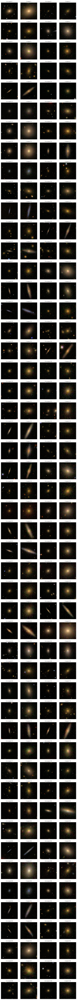

In [87]:
plt.figure(figsize=(8, 400))  # Adjust the figure size for 4 wide and 100 tall layout

# Define the number of rows and columns
rows = 100
cols = 4

for i, (img, cropped_img) in enumerate(zip(images, cropped_images)):
    # Display uncropped image
    plt.subplot(rows * 2, cols, 2 * i + 1)  # Odd index for uncropped image
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"Uncropped {i+1}", fontsize=8)
    
    # Display cropped image
    plt.subplot(rows * 2, cols, 2 * i + 2)  # Even index for cropped image
    plt.imshow(cropped_img)
    plt.axis('off')
    plt.title(f"Cropped {i+1}", fontsize=8)

plt.tight_layout()
plt.show()